## Running cNMF on adult and pediatric AML malignant cells and younger Controls.

We use scanpy for the basic filtering and plotting of the cNMF results. We are generting a new adata object from the counts file we exported using sc.read() function and then add the relevant metadata to the adata object.

 - Current as of April 2, 2022
 - bettina.nadorp@nyulangone.org

 

In [1]:
%matplotlib inline

import os
import pandas as pd
import numpy as np
from scipy.io import mmread
import scipy.sparse as sp
import matplotlib.pyplot as plt
from IPython.display import Image
import scanpy as sc
from matplotlib.pyplot import rc_context
import seaborn as sns


out_path='/gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/'
if not os.path.exists(out_path):
    os.mkdir(out_path)

data_path_adult='/gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-AML-malignant-control-cells/counts.h5ad'
data_path_ped='/gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-pediatric-AML-malignant-control-cells/counts.h5ad'

np.random.seed(14)
cwd = os.getcwd()
print("Current working directory: {0}".format(cwd))



Current working directory: /gpfs/data/aifantislab/home/nadorb01/projects/myeloid_sarcoma_v5/scripts/10_cNMF


In [2]:
# define scanpy plotting defaults:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=1000, frameon=False, vector_friendly=True, fontsize=14, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False)
sc._settings.ScanpyConfig(figdir=out_path+'figures/', plot_suffix='_adult_pediatric_AML_malignant_Control_cNMF')

## Read in adult and pediatric adata objects

In [3]:
adata_adult = sc.read(data_path_adult)
print(adata_adult)

AnnData object with n_obs × n_vars = 74085 × 18736
    obs: 'orig.ident', 'samples', 'Broad_cell_identity', 'gender', 'inflammation_group', 'ap_aml'
    var: 'n_cells'


In [4]:
adata_ped = sc.read(data_path_ped)
print(adata_ped)

AnnData object with n_obs × n_vars = 66950 × 19586
    obs: 'orig.ident', 'samples', 'Broad_cell_identity', 'gender', 'inflammation_group', 'ap_aml'
    var: 'n_cells'


## Concatenate

In [5]:
import anndata as ad
adata = ad.concat([adata_adult,adata_ped])

In [6]:
print(adata)


AnnData object with n_obs × n_vars = 141035 × 18197
    obs: 'orig.ident', 'samples', 'Broad_cell_identity', 'gender', 'inflammation_group', 'ap_aml'


In [ ]:
del adata_adult
del adata_ped

## Filter genes that are expressed in less than 50 cells
Try filtering more genes to reduce object size >50 cells

In [10]:
sc.pp.filter_genes(adata, min_cells=50) # filter genes detected in fewer than 50 cells

In [11]:
print(adata)

AnnData object with n_obs × n_vars = 141035 × 18197
    obs: 'orig.ident', 'samples', 'Broad_cell_identity', 'gender', 'inflammation_group', 'ap_aml'
    var: 'n_cells'


## Save the scanpy object to a file. This file will be passed as input to cNMF

In [3]:
count_adat_fn = out_path+'counts.h5ad'
sc.write(count_adat_fn, adata)


## In the cells below, we run the first 2 steps of cNMF assuming parallelization on a SLURM computing cluster:

    - prepare - normalizes the data for the run and specifies the input parameters
    - factorize - runs the actual factorization steps.
    
First the prepare step is run as before but specifying numworkers to be equal to the number of CPUs or compute nodes you want to distribute over.
Iterations with large number of cells are relatively slow ~10 iterations per hour with 32 workers. Only run 200+ iterations for k value that seems most stable at the end.

In [14]:
numiter=25 # Number of NMF replicates. Set this to a larger value ~200 for real data. We set this to a relatively low value here for illustration at a faster speed

numworkers=50 # Number of parallel factorization jobs to run. Set this to a value reflective of the number of cores on your computer.
numhvgenes=2000 ## Number of over-dispersed genes to use for running the factorizations

## Results will be saved to [output_directory]/[run_name] which in this example is example_PBMC/cNMF/pbmc_cNMF
output_directory = out_path
if not os.path.exists(output_directory):
    os.mkdir(output_directory)
run_name = 'adult_pediatric_AML_malignant_Control_cNMF'

## Specify the Ks to use as a space separated list in this case "5 6 7 8 9 10"
K = ' '.join([str(i) for i in range(20,36)])

seed = 14 ## Specify a seed pseudorandom number generation for reproducibility

## Path to the filtered counts dataset we output previously
countfn = out_path+'counts.h5ad'


In [15]:
prepare_cmd = 'python /gpfs/data/aifantislab/home/nadorb01/software/cNMF/cnmf.py prepare --output-dir %s --name %s -c %s -k %s --n-iter %d --total-workers %d --seed %d --numgenes %d --beta-loss frobenius' % (output_directory, run_name, countfn, K, numiter, numworkers, seed, numhvgenes)
print('Prepare command assuming parallelization with %d computing nodes:\n%s' % (numworkers, prepare_cmd))
! {prepare_cmd}

Prepare command assuming parallelization with 50 computing nodes:
python /gpfs/data/aifantislab/home/nadorb01/software/cNMF/cnmf.py prepare --output-dir /gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/ --name adult_pediatric_AML_malignant_Control_cNMF -c /gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/counts.h5ad -k 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 --n-iter 25 --total-workers 50 --seed 14 --numgenes 2000 --beta-loss frobenius


#### Schedules the tasks of 1 worker to each compute node assuming only a single processor per node, using slurm cluster manager

In [17]:
## Using SLURM
slurm_factorize_cmd = "sbatch --mem-per-cpu=4G --time=00-48:00:00 --array=1-%d --wrap='source /gpfs/data/aifantislab/home/nadorb01/software/miniconda3/etc/profile.d/conda.sh; conda activate cnmf_env; python /gpfs/data/aifantislab/home/nadorb01/software/cNMF/cnmf.py factorize --output-dir %s --name %s --worker-index $SLURM_ARRAY_TASK_ID'" % (numworkers, output_directory, run_name)
print('Factorize command to simultaneously run factorization over %d nodes of a compute cluster using SLURM:\n%s' % (numworkers, slurm_factorize_cmd))
!{slurm_factorize_cmd}
# should have been 72h

Factorize command to simultaneously run factorization over 50 nodes of a compute cluster using SLURM:
sbatch --mem-per-cpu=4G --time=00-48:00:00 --array=1-50 --wrap='source /gpfs/data/aifantislab/home/nadorb01/software/miniconda3/etc/profile.d/conda.sh; conda activate cnmf_env; python /gpfs/data/aifantislab/home/nadorb01/software/cNMF/cnmf.py factorize --output-dir /gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/ --name adult_pediatric_AML_malignant_Control_cNMF --worker-index $SLURM_ARRAY_TASK_ID'
Submitted batch job 16658746


#### Whether or not you used parallelization in the above steps, you should resume here with the combine step below which combines the individual factorization replicates so that the consensus estimate can be taken

In [21]:
cmd = 'python /gpfs/data/aifantislab/home/nadorb01/software/cNMF/cnmf.py combine --output-dir %s --name %s' % (output_directory, run_name)
print(cmd)
!{cmd}

python /gpfs/data/aifantislab/home/nadorb01/software/cNMF/cnmf.py combine --output-dir /gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/ --name adult_pediatric_AML_malignant_Control_cNMF
Combining factorizations for k=20.
Combining factorizations for k=21.
Combining factorizations for k=22.
Combining factorizations for k=23.
Combining factorizations for k=24.
Combining factorizations for k=25.
Combining factorizations for k=26.
Combining factorizations for k=27.
Combining factorizations for k=28.
Combining factorizations for k=29.
Combining factorizations for k=30.
Combining factorizations for k=31.
Combining factorizations for k=32.
Combining factorizations for k=33.
Combining factorizations for k=34.
Combining factorizations for k=35.


## Compute the stability and error at each choice of K to see if a clear choice jumps out.

Please note that the maximum stability solution is not always the best choice depending on the application. However it is often a good starting point even if you have to investigate several choices of K

In [22]:
kselect_plot_cmd = 'python /gpfs/data/aifantislab/home/nadorb01/software/cNMF/cnmf.py k_selection_plot --output-dir %s --name %s' % (output_directory, run_name)
print('K selection plot command: %s' % kselect_plot_cmd)
!{kselect_plot_cmd}

K selection plot command: python /gpfs/data/aifantislab/home/nadorb01/software/cNMF/cnmf.py k_selection_plot --output-dir /gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/ --name adult_pediatric_AML_malignant_Control_cNMF


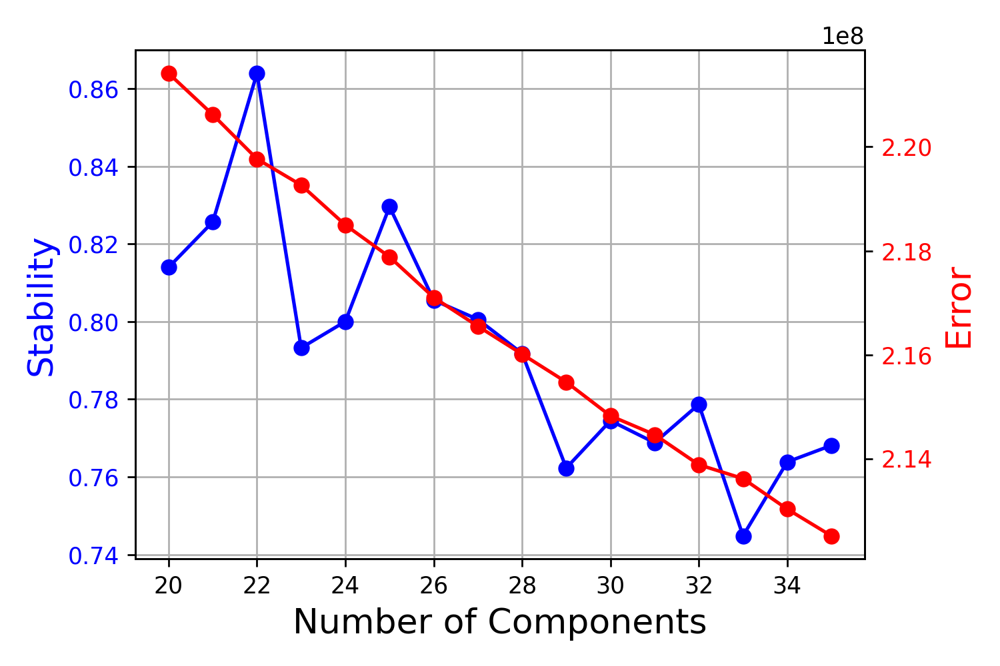

In [23]:
Image(filename = (out_path+run_name+'/'+run_name+'.k_selection.png'), width=1000, height=1000)


## K = 22

In [3]:
numiter=250 # Number of NMF replicates. Set this to a larger value ~200 for real data. We set this to a relatively low value here for illustration at a faster speed

numworkers=50 # Number of parallel factorization jobs to run. Set this to a value reflective of the number of cores on your computer.
numhvgenes=2000 ## Number of over-dispersed genes to use for running the factorizations

## Results will be saved to [output_directory]/[run_name] which in this example is example_PBMC/cNMF/pbmc_cNMF
output_directory = out_path
if not os.path.exists(output_directory):
    os.mkdir(output_directory)
run_name = 'adult_pediatric_AML_malignant_Control_cNMF_final_22'

K = "22"

seed = 14 ## Specify a seed pseudorandom number generation for reproducibility

## Path to the filtered counts dataset we output previously
countfn = out_path+'counts.h5ad'


In [29]:
prepare_cmd = 'python ../../../../software/cNMF/cnmf.py prepare --output-dir %s --name %s -c %s -k %s --n-iter %d --total-workers %d --seed %d --numgenes %d --beta-loss frobenius' % (output_directory, run_name, countfn, K, numiter, numworkers, seed, numhvgenes)
print('Prepare command assuming parallelization with %d computing nodes:\n%s' % (numworkers, prepare_cmd))
! {prepare_cmd}

Prepare command assuming parallelization with 50 computing nodes:
python ../../../../software/cNMF/cnmf.py prepare --output-dir /gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/ --name adult_pediatric_AML_malignant_Control_cNMF_final_22 -c /gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/counts.h5ad -k 22 --n-iter 250 --total-workers 50 --seed 14 --numgenes 2000 --beta-loss frobenius


In [30]:
## Using SLURM
uger_factorize_cmd = "sbatch --mem-per-cpu=4G --time=00-72:00:00 --array=1-%d --wrap='source /gpfs/data/aifantislab/home/nadorb01/software/miniconda3/etc/profile.d/conda.sh; conda activate cnmf_env; python ../../../../software/cNMF/cnmf.py factorize --output-dir %s --name %s --worker-index $SLURM_ARRAY_TASK_ID'" % (numworkers, output_directory, run_name)
print('Factorize command to simultaneously run factorization over %d nodes of a compute cluster using SLURM:\n%s' % (numworkers, uger_factorize_cmd))
!{uger_factorize_cmd}

Factorize command to simultaneously run factorization over 50 nodes of a compute cluster using SLURM:
sbatch --mem-per-cpu=4G --time=00-72:00:00 --array=1-50 --wrap='source /gpfs/data/aifantislab/home/nadorb01/software/miniconda3/etc/profile.d/conda.sh; conda activate cnmf_env; python ../../../../software/cNMF/cnmf.py factorize --output-dir /gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/ --name adult_pediatric_AML_malignant_Control_cNMF_final_22 --worker-index $SLURM_ARRAY_TASK_ID'
Submitted batch job 16679413


In [9]:
# combine solutions:
# merge spectra
cmd = 'python ../../../../software/cNMF/cnmf.py combine --output-dir %s --name %s' % (output_directory, run_name)
print(cmd)
!{cmd}

python ../../../../software/cNMF/cnmf.py combine --output-dir /gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/ --name adult_pediatric_AML_malignant_Control_cNMF_final_22
Combining factorizations for k=22.


In [49]:
selected_K = 22
density_threshold = 2.00
run_name = 'adult_pediatric_AML_malignant_Control_cNMF_final_22'


In [27]:

## This is the command you would run from the command line to obtain the consensus estimate with no filtering
## and to save a diagnostic plot as a PDF
consensus_cmd = 'python ../../../../software/cNMF/cnmf.py consensus --output-dir %s --name %s --local-density-threshold %.2f --components %d --show-clustering' % (output_directory, run_name, density_threshold, selected_K)
print('Consensus command for K=22:\n%s' % consensus_cmd)
!{consensus_cmd}

Consensus command for K=22:
python ../../../../software/cNMF/cnmf.py consensus --output-dir /gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/ --name adult_pediatric_AML_malignant_Control_cNMF_final_22 --local-density-threshold 2.00 --components 22 --show-clustering


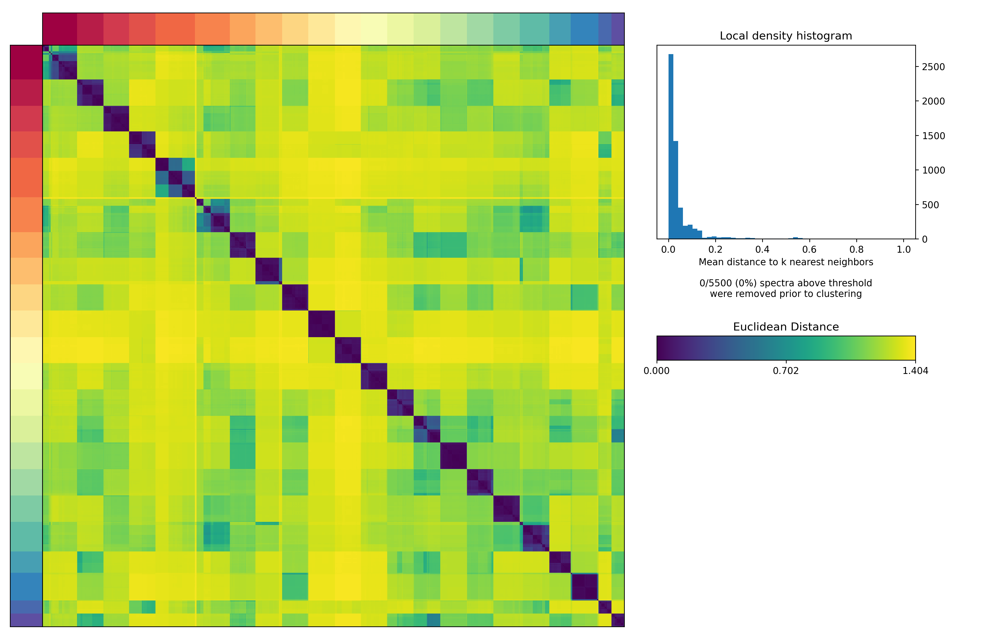

In [37]:
density_threshold_str = ('%.2f' % density_threshold).replace('.', '_')
Image(filename = out_path+run_name+'/'+run_name+".clustering.k_%d.dt_%s.png" % (selected_K, density_threshold_str),
      width=1000, height=1000)


The above consensus plot shows that there is a substantial degree of concordance between the replicates with a few outliers. An outlier threshold of 0.2 seems appropriate

In [ ]:
density_threshold = 0.04
## This is the command you would run from the command line to obtain the consensus estimate with no filtering
## and to save a diagnostic plot as a PDF
consensus_cmd = 'python ../../../../software/cNMF/cnmf.py consensus --output-dir %s --name %s --local-density-threshold %.2f --components %d --show-clustering' % (output_directory, run_name, density_threshold, selected_K)
print('Consensus command for K=%d:\n%s' % (selected_K, consensus_cmd))
!{consensus_cmd}

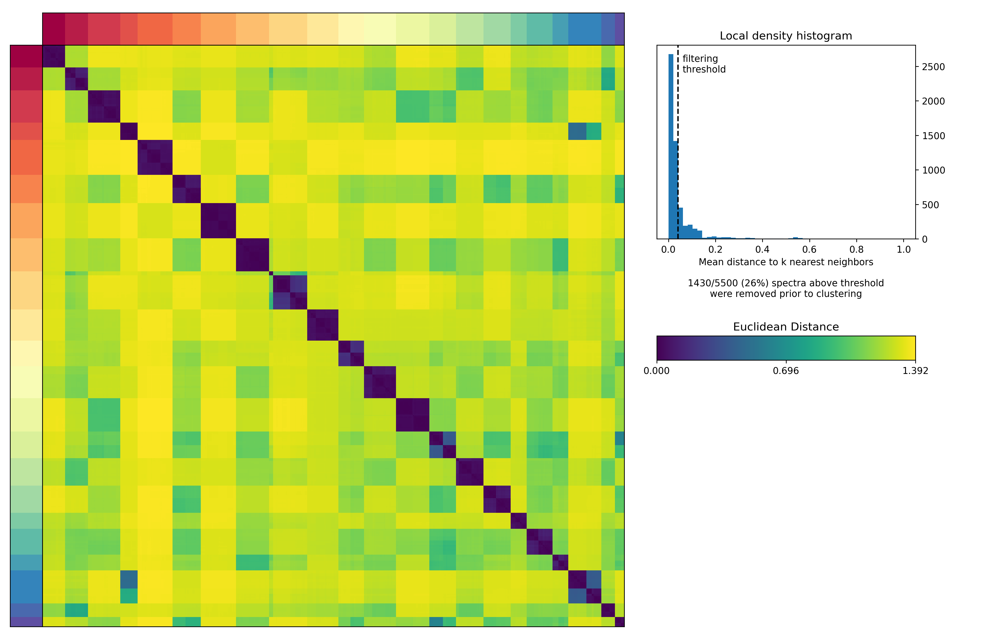

In [54]:
density_threshold = 0.04
density_threshold_str = ('%.2f' % density_threshold).replace('.', '_')
Image(filename = out_path+run_name+'/'+run_name+".clustering.k_%d.dt_%s.png" % (selected_K, density_threshold_str),
      width=1000, height=1000)


## The steps below load the AnnData object, TPT normalize it, mean and variance normalize each gene, run PCA, and run UMAP. We use the same set of high-variance genes that were determined prior to running cNMF which we obtain as the columns of the raw output file:



In [4]:
# adata = sc.read(countfn)
run_name='adult_pediatric_AML_malignant_Control_cNMF_final_22'

In [6]:
## Obtain high variance genes that were used for cNMF as these were saved to a text file
hvgs = open(out_path+run_name+'/'+run_name+'.overdispersed_genes.txt').read().split('\n')


In [7]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=10**4) ## TPT normalization

In [8]:
## Set log-normalized data to the raw attribute of the AnnData object to make it easy to plot expression levels of individual genes.
## This does not log normalize the actual AnnData data matrix
adata.raw = sc.pp.log1p(adata.copy(), copy=True)

In [9]:
## Subset out only the high-variance genes

adata = adata[:,hvgs]

In [10]:
## Mean and variance normalize the genes

sc.pp.scale(adata)

/gpfs/data/aifantislab/home/nadorb01/software/miniconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:806: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [11]:
# ## Run PCA

sc.pp.pca(adata)

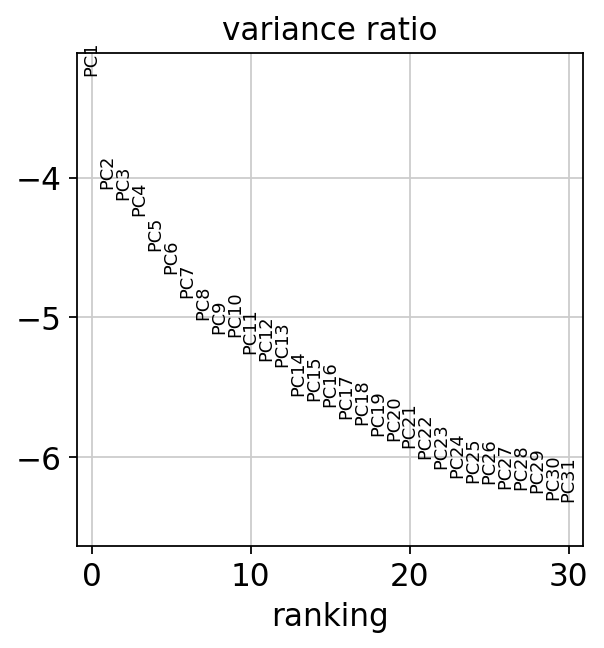

In [12]:
# ## Make a scree plot to determine number of PCs to use for UMAP

sc.pl.pca_variance_ratio(adata, log=True)

In [13]:
# ## Construct the nearest neighbor graph for UMAP

sc.pp.neighbors(adata, n_neighbors=30, n_pcs=30)

/gpfs/home/nadorb01/.local/lib/python3.7/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../home/nadorb01/.local/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/gpfs/home/nadorb01/.local/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../home

In [14]:
# ## Run UMAP

sc.tl.umap(adata)

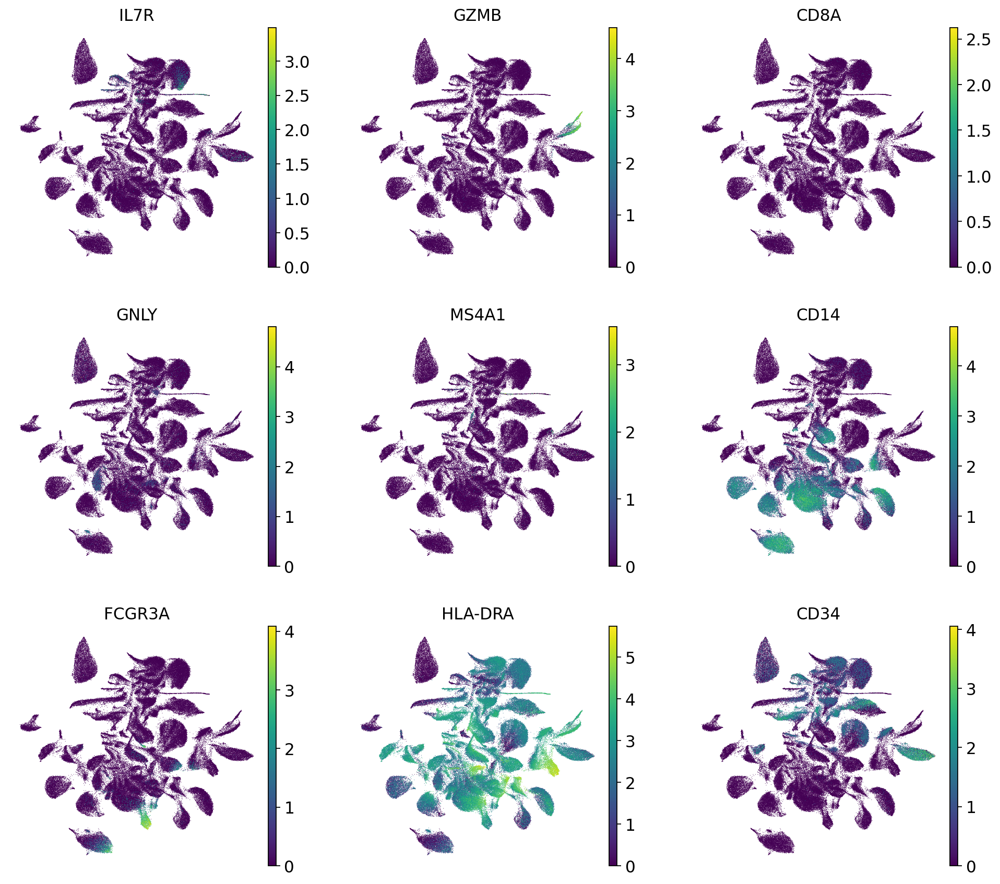

In [15]:
# ## Plot the UMAP with some cannonical marker genes to see that the apparent clustering makes sense

sc.pl.umap(adata, color=['IL7R', 'GZMB', 'CD8A','GNLY',
                         'MS4A1', 'CD14', 'FCGR3A', 'HLA-DRA', 'CD34'],
           use_raw=True, ncols=3)

In [6]:
dimred_adata = out_path+'malignant_control_adult_peds_processed_k22.h5ad'
# sc.write(dimred_adata, adata)

adata=sc.read(dimred_adata)

In [9]:
adata

AnnData object with n_obs × n_vars = 141035 × 2000
    obs: 'orig.ident', 'samples', 'Broad_cell_identity', 'gender', 'inflammation_group', 'ap_aml', 'n_counts', 'Broad_cell_identity_control', 'Usage_1', 'Usage_2', 'Usage_3', 'Usage_4', 'Usage_5', 'Usage_6', 'Usage_7', 'Usage_8', 'Usage_9', 'Usage_10', 'Usage_11', 'Usage_12', 'Usage_13', 'Usage_14', 'Usage_15', 'Usage_16', 'Usage_17', 'Usage_18', 'Usage_19', 'Usage_20', 'Usage_21', 'Usage_22'
    var: 'n_cells', 'mean', 'std'
    uns: 'Broad_cell_identity_colors', 'Broad_cell_identity_control_colors', 'ap_aml_colors', 'inflammation_group_colors', 'neighbors', 'pca', 'samples_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

## First we load the raw usage file that was output by cNMF. cNMF does not normalize the usages to sum to 1 for each cell so we do that as a subsequent step in the second cell below

In [5]:

selected_K=22
density_threshold_str='0_04'

usage = pd.read_csv(out_path+'/'+run_name+'/'+run_name+'.usages.k_%d.dt_%s.consensus.txt' % (selected_K, density_threshold_str),
                    sep='\t', index_col=0)
usage.columns = ['Usage_%s' % i for i in usage.columns]
# print(usage)

In [6]:
usage_norm = usage.div(usage.sum(axis=1), axis=0)
usage_norm.head()

,Usage_1,Usage_2,Usage_3,Usage_4,Usage_5,Usage_6,Usage_7,Usage_8,Usage_9,Usage_10,...,Usage_13,Usage_14,Usage_15,Usage_16,Usage_17,Usage_18,Usage_19,Usage_20,Usage_21,Usage_22
2019-07-01-count-1:AAACCCAAGACTCTTG,0.0,0.499312,0.116491,0.000000,0.000000,0.014075,0.000000,0.000000,0.000000,0.089485,...,0.041914,0.000000,0.000000,0.000000,0.238724,0.000000,0.0,0.000000,0.0,0.0
2019-07-01-count-1:AAACCCACAAATGGCG,0.0,0.717894,0.000000,0.028871,0.001699,0.025762,0.001585,0.012615,0.067617,0.000000,...,0.013223,0.000000,0.002071,0.012612,0.035885,0.052299,0.0,0.000000,0.0,0.0
2019-07-01-count-1:AAACCCAGTACTAGCT,0.0,0.456220,0.000000,0.008681,0.000000,0.052515,0.000000,0.000000,0.165603,0.016644,...,0.000000,0.000000,0.000000,0.009729,0.256680,0.033123,0.0,0.000000,0.0,0.0
2019-07-01-count-1:AAACCCAGTAGACGTG,0.0,0.772435,0.039371,0.000000,0.000000,0.000000,0.010085,0.025150,0.000000,0.016992,...,0.050107,0.000000,0.000000,0.001841,0.000000,0.044350,0.0,0.000000,0.0,0.0
2019-07-01-count-1:AAACCCATCGCTGATA,0.0,0.737242,0.051015,0.000000,0.000000,0.000000,0.027762,0.001021,0.061927,0.001443,...,0.030243,0.022536,0.000000,0.019732,0.019692,0.000000,0.0,0.027385,0.0,0.0


In [60]:
adata.obs = pd.merge(left=adata.obs, right=usage_norm, how='left', left_index=True, right_index=True)

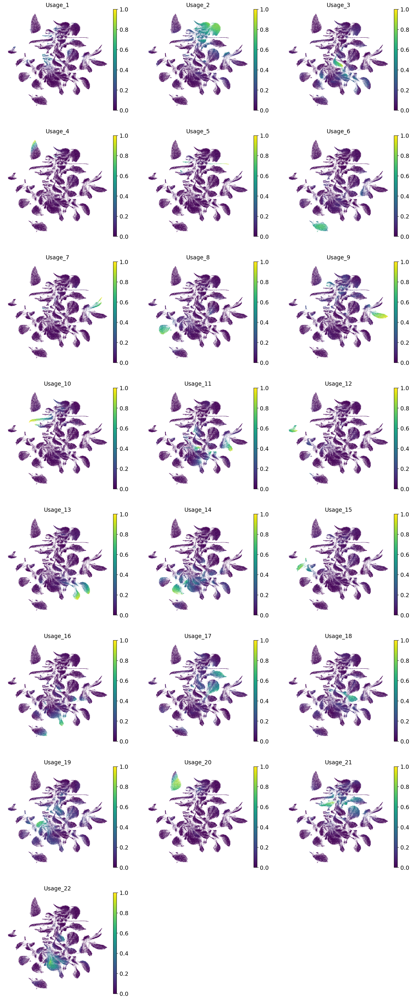

In [61]:
with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata, color=usage_norm.columns,
               use_raw=True, ncols=3, vmin=0, vmax=1, frameon=False)

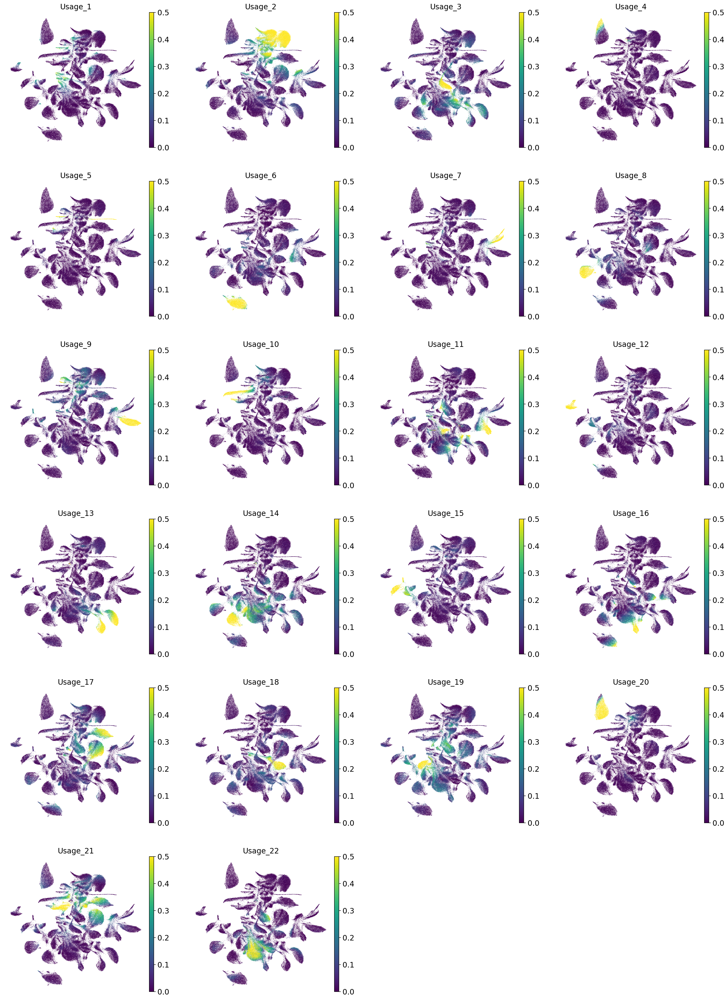

In [41]:
with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata, color=usage_norm.columns,
           use_raw=True, ncols=4, vmin=0, vmax=0.5, frameon=False, save="_features_k22_adult_peds_vmax50.pdf")
    


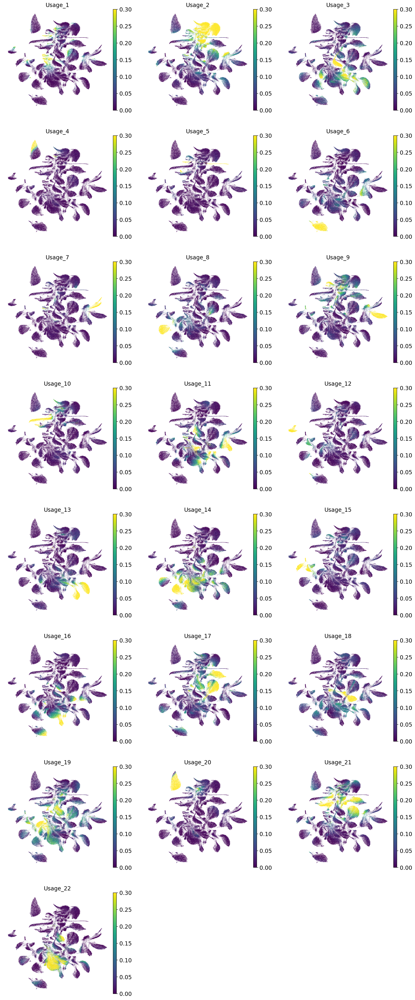

In [63]:
with rc_context({'figure.figsize': (5, 5)}):    
    sc.pl.umap(adata, color=usage_norm.columns,
           use_raw=True, ncols=3, vmin=0, vmax=0.3, frameon=False)

In [10]:
# define samplecolors in dictionary and add as palette=dict
samplecolors=["#7FCDBB","#41B6C4","#1D91C0","#225EA8","#253494","#081D58","#3690C0","#02818A","#016C59","#014636", "#FED976","#FEB24C","#FD8D3C","#FC4E2A","#E31A1C","#BD0026","#800026","#FDAE6B","#FD8D3C","#F16913","#D94801","#A63603","#7F2704","#FCBBA1","#FC9272","#FB6A4A","#EF3B2C","#CB181D","#A50F15","#67000D", "#FCC5C0","#FA9FB5","#F768A1","#DD3497","#AE017E","#7A0177","#49006A","#DADAEB","#BCBDDC","#9E9AC8","#807DBA","#6A51A3","#54278F","#3F007D","#E0ECF4","#BFD3E6","#9EBCDA","#8C96C6","#8C6BB1","#88419D","#810F7C","#4D004B"]
adata.obs['samples'].cat.reorder_categories(["Control1", "Control4", "Control0005","Control0058", "Control0082","Control2", "Control3", "Control5","Control4003","Control0004", "AML0024","AML0048","AML0114","AML0160","AML0310","AML0361","AML0612","AML0693","AML1371","AML2123","AML2451","AML2910","AML3050","AML3133","AML3266","AML3730","AML3762","AML3948","AML4340","AML4897","AML001","AML003","AML005","AML006","AML008","AML009","AML012","AML022","AML025","AML026","AML028","AML038","AML043","AML048","AML051","AML052","AML055","AML056","AML073","PAUMTZ","PAWWEE","PAXMIJ"], inplace=True)

adata.obs['Broad_cell_identity'].cat.reorder_categories(['HSC', 'MPP', 'GMP','MEP','LymP','DC precursor','pDC', 'cDC1', 'cDC2', 'CD14+ monocyte', 'CD16+ monocyte', 'HLA-II+ monocyte' ,'Granulocyte','CD11c+' ], inplace=True)
colors=["#C7E9B4","#7FCDBB","#41B6C4","#1D91C0","#225EA8","#F768A1", "#DD3497","#AE017E","#7A0177","#FDAE6B","#FD8D3C","#F16913","#D94801","#A63603"]


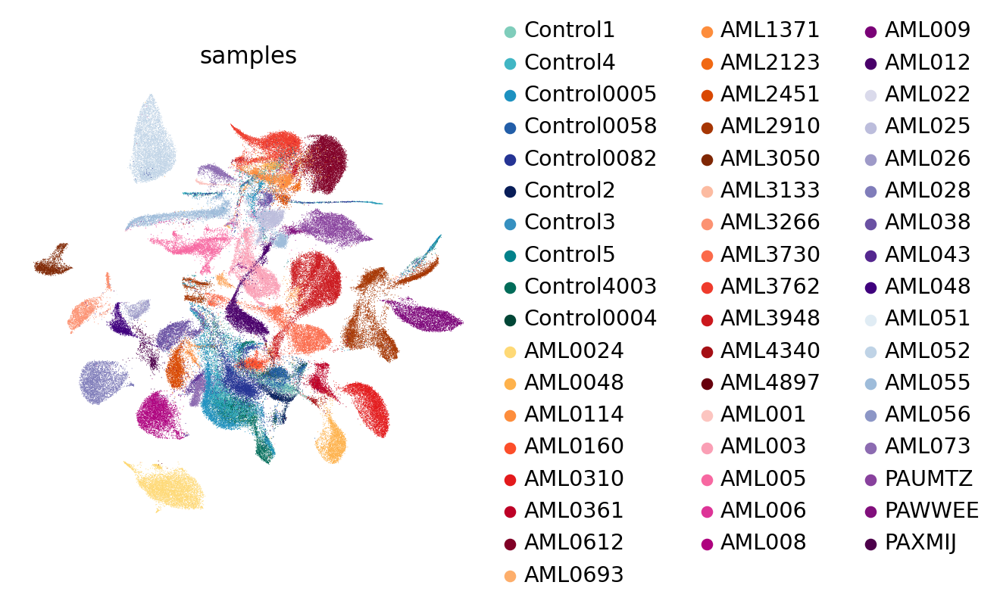

In [19]:
#print(out_path+'UMAP_samples.pdf')
with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata, color='samples', palette=samplecolors, frameon=False, save='_samples_adult_peds_control.pdf',)

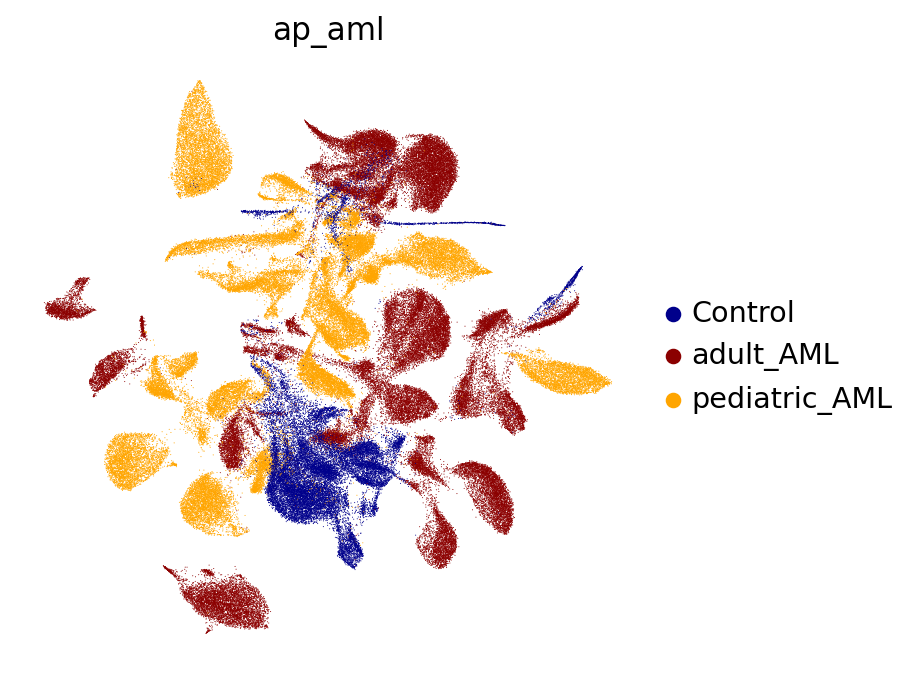

In [20]:

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata, color='ap_aml', palette=['darkblue','darkred','orange'], frameon=False, save='_adult_peds_control.pdf',)

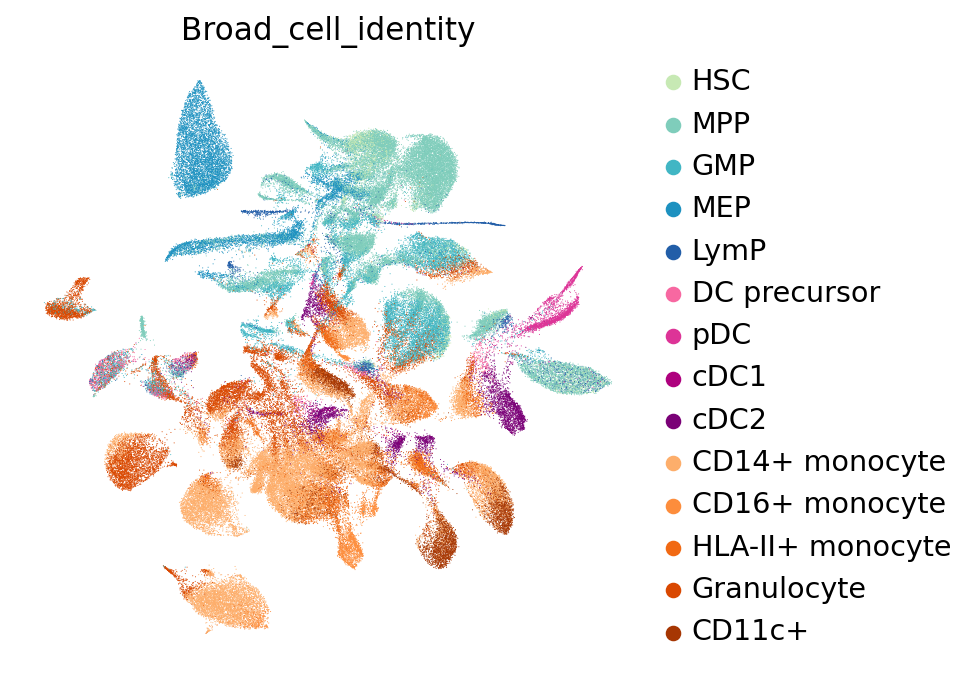

In [21]:
with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata, color='Broad_cell_identity', palette=colors, frameon=False,save='_Broad_cell_identity_adult_peds_control.pdf',)

In [11]:
# cell type annotations only for controls:
adata.obs['Broad_cell_identity_control'] = np.where(adata.obs['ap_aml']!='Control', 'AML', adata.obs['Broad_cell_identity'])
adata.obs['Broad_cell_identity_control'] = adata.obs['Broad_cell_identity_control'].astype('category')
adata.obs['Broad_cell_identity_control'].cat.reorder_categories(['HSC', 'MPP', 'GMP','MEP','LymP','DC precursor','pDC', 'cDC1', 'cDC2', 'CD14+ monocyte', 'CD16+ monocyte', 'HLA-II+ monocyte' ,'Granulocyte','CD11c+', 'AML' ], inplace=True)
colors_c=["#C7E9B4","#7FCDBB","#41B6C4","#1D91C0","#225EA8","#F768A1", "#DD3497","#AE017E","#7A0177","#FDAE6B","#FD8D3C","#F16913","#D94801","#A63603", "grey"]


with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata, color='Broad_cell_identity_control', palette=colors_c, frameon=False,save='_Broad_cell_identity_adult_peds_control_control_only.pdf',)

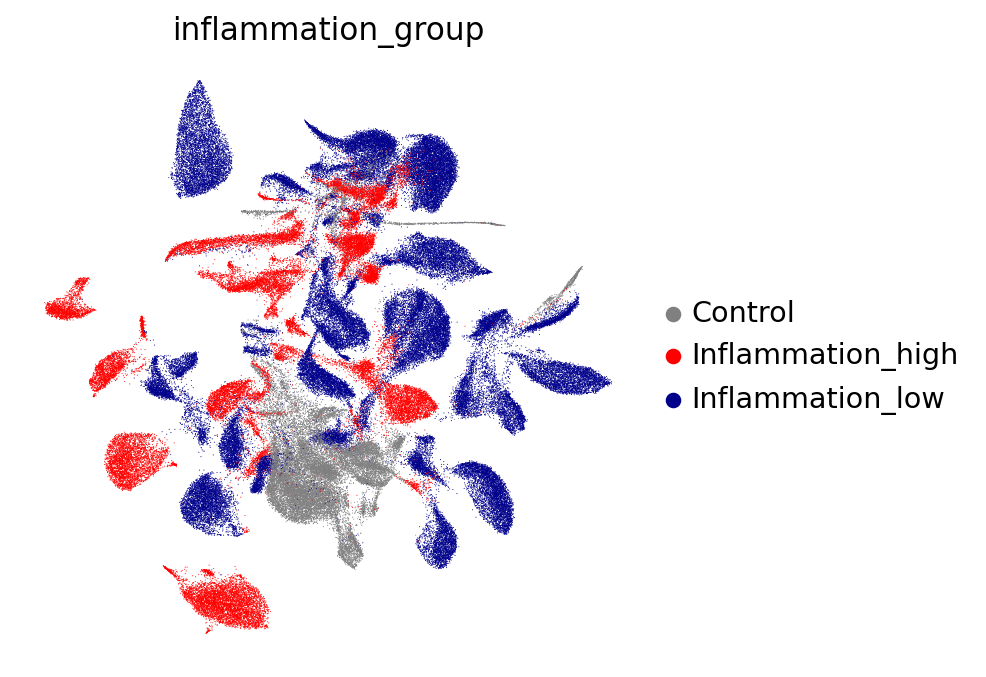

In [23]:
with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata, color='inflammation_group', palette=['grey', 'red', 'darkblue'], frameon=False,save='_inflammation_group_adult_peds_control.pdf',)

In [7]:
# out_path='/gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-pediatric-AML-malignant-control-cells/pediatric_AML_malignant_Control_cNMF_final/'
dimred_adata = out_path+'malignant_control_adult_peds_processed_k22.h5ad'
# sc.write(dimred_adata, adata)
adata=sc.read(dimred_adata)

## The usage of some features roughly overlaps with the expression of marker genes

## Can we identify expression profiles that associate with inflammation status

a) Plot heatmaps of GEP usage in high and low inflammation patients
b) split additionally by adult and pediatric


In [7]:
# number of cells for some reason does not match! Use data in adata
# usage_matrix = pd.read_csv('../../../ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-cells/AML_malignant_cNMF_final/AML_malignant_cNMF_final.usages.k_27.dt_0_20.consensus.txt' ,
#                     sep='\t', index_col=0)
normalized_usage_matrix = adata.obs.loc[:, adata.obs.columns.str.startswith('Usage_')]
normalized_usage_matrix.columns = normalized_usage_matrix.columns.str.lstrip("Usage_")
normalized_usage_matrix.columns = np.arange(1,23)
normalized_usage_matrix

,1,2,3,4,5,6,7,8,9,10,...,13,14,15,16,17,18,19,20,21,22
2019-07-01-count-1:AAACCCAAGACTCTTG,0.000000,0.499312,0.116491,0.000000,0.000000,0.014075,0.000000,0.000000,0.000000,0.089485,...,0.041914,0.000000,0.000000,0.000000,0.238724,0.000000,0.000000,0.000000,0.000000,0.000000
2019-07-01-count-1:AAACCCACAAATGGCG,0.000000,0.717894,0.000000,0.028871,0.001699,0.025762,0.001585,0.012615,0.067617,0.000000,...,0.013223,0.000000,0.002071,0.012612,0.035885,0.052299,0.000000,0.000000,0.000000,0.000000
2019-07-01-count-1:AAACCCAGTACTAGCT,0.000000,0.456220,0.000000,0.008681,0.000000,0.052515,0.000000,0.000000,0.165603,0.016644,...,0.000000,0.000000,0.000000,0.009729,0.256680,0.033123,0.000000,0.000000,0.000000,0.000000
2019-07-01-count-1:AAACCCAGTAGACGTG,0.000000,0.772435,0.039371,0.000000,0.000000,0.000000,0.010085,0.025150,0.000000,0.016992,...,0.050107,0.000000,0.000000,0.001841,0.000000,0.044350,0.000000,0.000000,0.000000,0.000000
2019-07-01-count-1:AAACCCATCGCTGATA,0.000000,0.737242,0.051015,0.000000,0.000000,0.000000,0.027762,0.001021,0.061927,0.001443,...,0.030243,0.022536,0.000000,0.019732,0.019692,0.000000,0.000000,0.027385,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-03-09-count1_0.95:TTTGGTTCACATATCG,0.000000,0.000000,0.011431,0.000000,0.000000,0.000000,0.000000,0.019767,0.075801,0.000000,...,0.000000,0.238473,0.000000,0.253170,0.002755,0.000000,0.113468,0.000000,0.000000,0.214705
2021-03-09-count1_0.95:TTTGGTTGTGCCTATA,0.012285,0.064553,0.017105,0.000000,0.015662,0.000000,0.000000,0.015435,0.737635,0.000000,...,0.000000,0.000000,0.064171,0.000000,0.027841,0.000000,0.021255,0.000981,0.021846,0.000000
2021-03-09-count1_0.95:TTTGGTTGTTGGGCCT,0.008939,0.000000,0.003890,0.000000,0.000000,0.000000,0.000000,0.000000,0.000671,0.000000,...,0.028269,0.303124,0.000000,0.086229,0.000000,0.041546,0.253072,0.000000,0.000000,0.191989
2021-03-09-count1_0.95:TTTGGTTTCGGCTTGG,0.001182,0.017590,0.014237,0.000000,0.001166,0.000000,0.000000,0.000000,0.016823,0.027278,...,0.000000,0.246378,0.000000,0.210124,0.000000,0.000000,0.192373,0.000000,0.011521,0.192508


In [8]:
## Get the % of cells of a cluster that have a >.25 usage of each GEP
usage_by_cluster = normalized_usage_matrix.groupby(adata.obs['Broad_cell_identity'], axis=0).apply(lambda x: (x>.25).mean())

## Order the GEPs to match up to the published clusters
cluster_order = ['HSC', 'MPP', 'GMP','MEP','LymP','DC precursor','pDC', 'cDC1', 'cDC2', 'CD14+ monocyte', 'CD16+ monocyte', 'HLA-II+ monocyte' ,'Granulocyte','CD11c+' ]
gep_order = np.arange(1,23)
usage_by_cluster = usage_by_cluster.loc[cluster_order, gep_order]
usage_by_cluster.head()

,1,2,3,4,5,6,7,8,9,10,...,13,14,15,16,17,18,19,20,21,22
Broad_cell_identity,,,,,,,,,,,,,,,,,,,,,
HSC,0.000000,0.567403,0.001142,0.000000,0.000762,0.000381,0.000381,0.000000,0.234958,0.000381,...,0.000000,0.000000,0.000000,0.000000,0.255141,0.002666,0.000762,0.000000,0.052932,0.000000
MPP,0.000266,0.658568,0.001731,0.000266,0.001331,0.000000,0.000300,0.000166,0.148001,0.021000,...,0.000732,0.000233,0.020002,0.000000,0.036576,0.005125,0.006057,0.004260,0.183579,0.000000
GMP,0.069872,0.108344,0.004908,0.000217,0.000505,0.000072,0.010899,0.003320,0.019706,0.005991,...,0.000144,0.000072,0.071387,0.000000,0.438502,0.010250,0.035513,0.001444,0.405082,0.000144
MEP,0.009582,0.136799,0.000379,0.122854,0.000000,0.000000,0.000000,0.000000,0.002277,0.238687,...,0.000095,0.000000,0.000759,0.000095,0.013281,0.000000,0.000474,0.526136,0.103406,0.000095
LymP,0.075209,0.109680,0.000000,0.000348,0.333914,0.000000,0.004178,0.000000,0.292131,0.000000,...,0.000000,0.000000,0.065460,0.000000,0.020891,0.090181,0.010446,0.000348,0.073816,0.000000


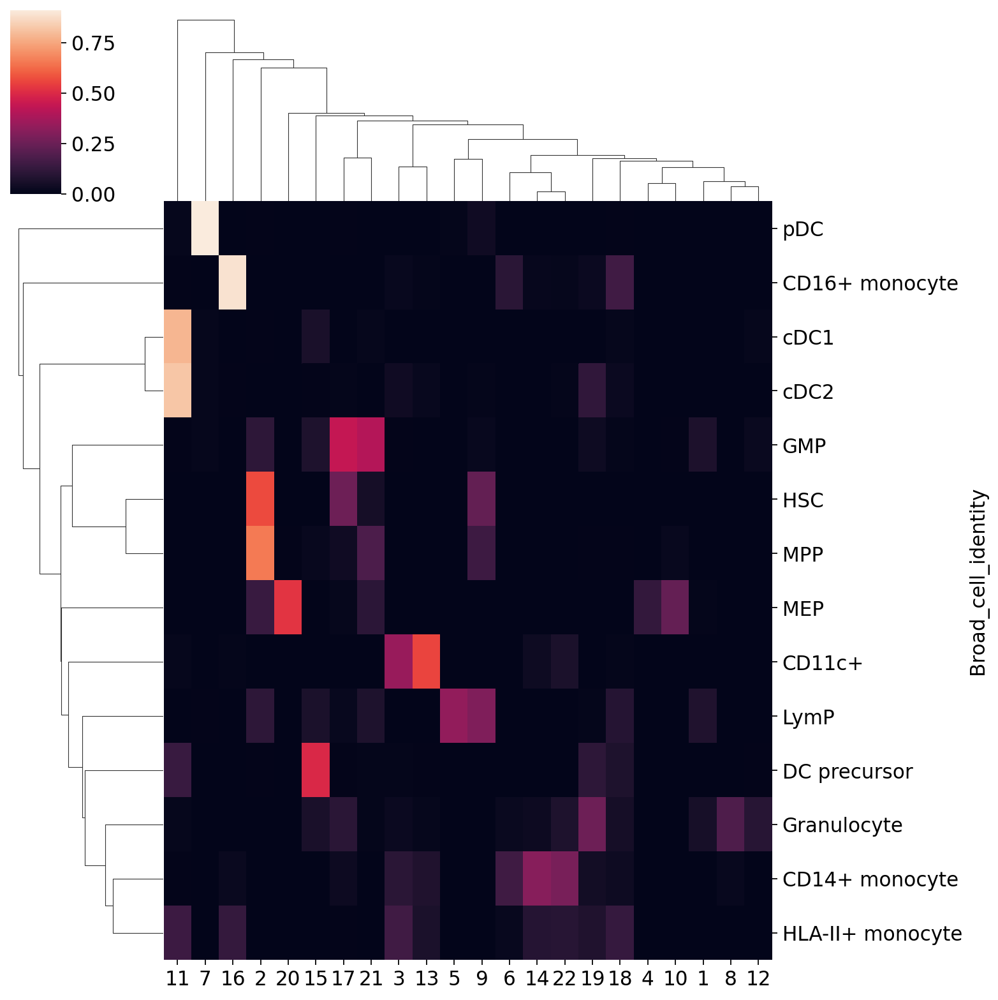

In [21]:

sns.clustermap(usage_by_cluster, xticklabels=True,)


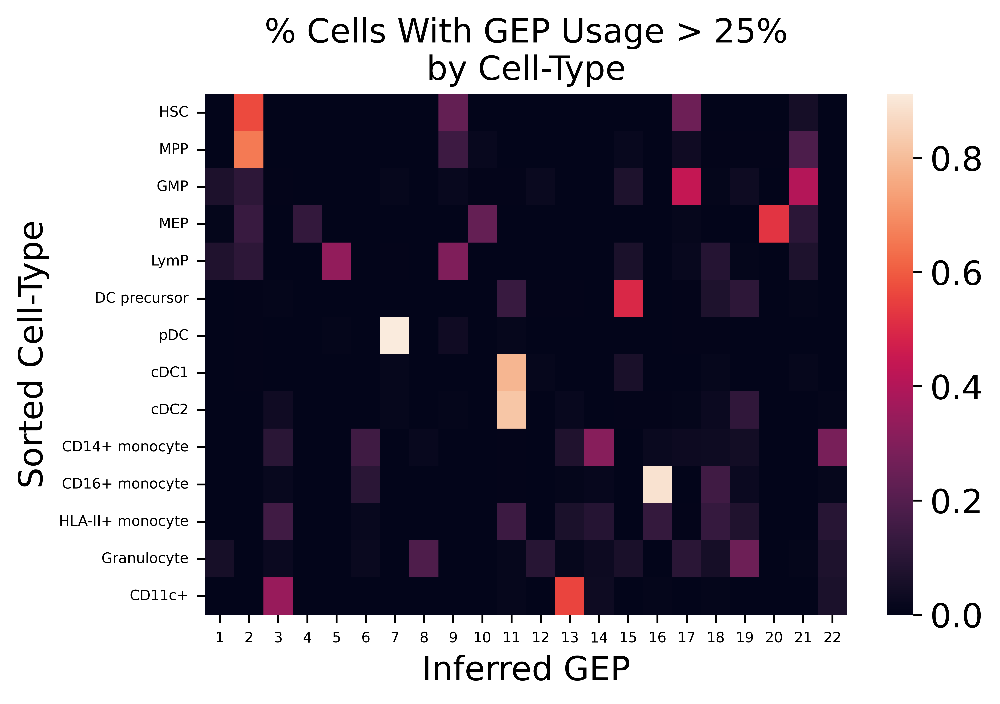

In [23]:
# gep_order = [3,11,1,15, 25,5,24,6, 10, 17, 13,19, 23,2, 4,22, 27,9,16,7, 8,20,12,14,18,21,26, 28,29,30 ]
cluster_order = ['HSC', 'MPP', 'GMP','MEP','LymP','DC precursor','pDC', 'cDC1', 'cDC2', 'CD14+ monocyte', 'CD16+ monocyte', 'HLA-II+ monocyte' ,'Granulocyte','CD11c+' ]
# gep_order = [2,23,4,6,7,9,13,1,22,8,17,3,5,10,11,12,14,15,16,18,19,20,21,24,25,26,27]

usage_by_cluster = usage_by_cluster.loc[cluster_order, gep_order]


(fig,ax) = plt.subplots(1,1,figsize=(6,4), dpi=500)
sns.heatmap(usage_by_cluster, ax=ax)
ax.set_title('% Cells With GEP Usage > 25%\nby Cell-Type')
ax.set_ylabel('Sorted Cell-Type')
ax.set_xlabel('Inferred GEP')
ax.set_yticks(np.arange(14)+.5)
ax.set_yticklabels(cluster_order, fontsize=6)

ax.set_xticks(np.arange(22)+.5)
_ = ax.set_xticklabels(gep_order, fontsize=6)



## Is there different association between Control and AML

In [9]:
normalized_usage_matrix_pedAML = normalized_usage_matrix[adata.obs['ap_aml']=='pediatric_AML']
normalized_usage_matrix_AML = normalized_usage_matrix[adata.obs['ap_aml']=='adult_AML']
normalized_usage_matrix_Control = normalized_usage_matrix[adata.obs['ap_aml']=='Control']
adata_obs_pedAML = adata.obs[adata.obs['ap_aml']=='pediatric_AML']
adata_obs_AML = adata.obs[adata.obs['ap_aml']=='adult_AML']
adata_obs_Control = adata.obs[adata.obs['ap_aml']=='Control']

In [10]:
normalized_usage_matrix_allAML = normalized_usage_matrix[adata.obs['ap_aml']!='Control']
adata_obs_allAML = adata.obs[adata.obs['ap_aml']!='Control']

### Control Cells

In [11]:
## Get the % of cells of a cluster that have a >.25 usage of each GEP
usage_by_cluster_Control = normalized_usage_matrix_Control.groupby(adata_obs_Control['Broad_cell_identity'], axis=0).apply(lambda x: (x>.25).mean())

## Order the GEPs to match up to the published clusters
cluster_order = ['HSC', 'MPP', 'GMP','MEP','LymP','DC precursor','pDC', 'cDC1', 'cDC2', 'CD14+ monocyte', 'CD16+ monocyte', 'HLA-II+ monocyte' ,'Granulocyte','CD11c+' ]
gep_order = np.arange(1,23)
usage_by_cluster_Control = usage_by_cluster_Control.loc[cluster_order, gep_order]


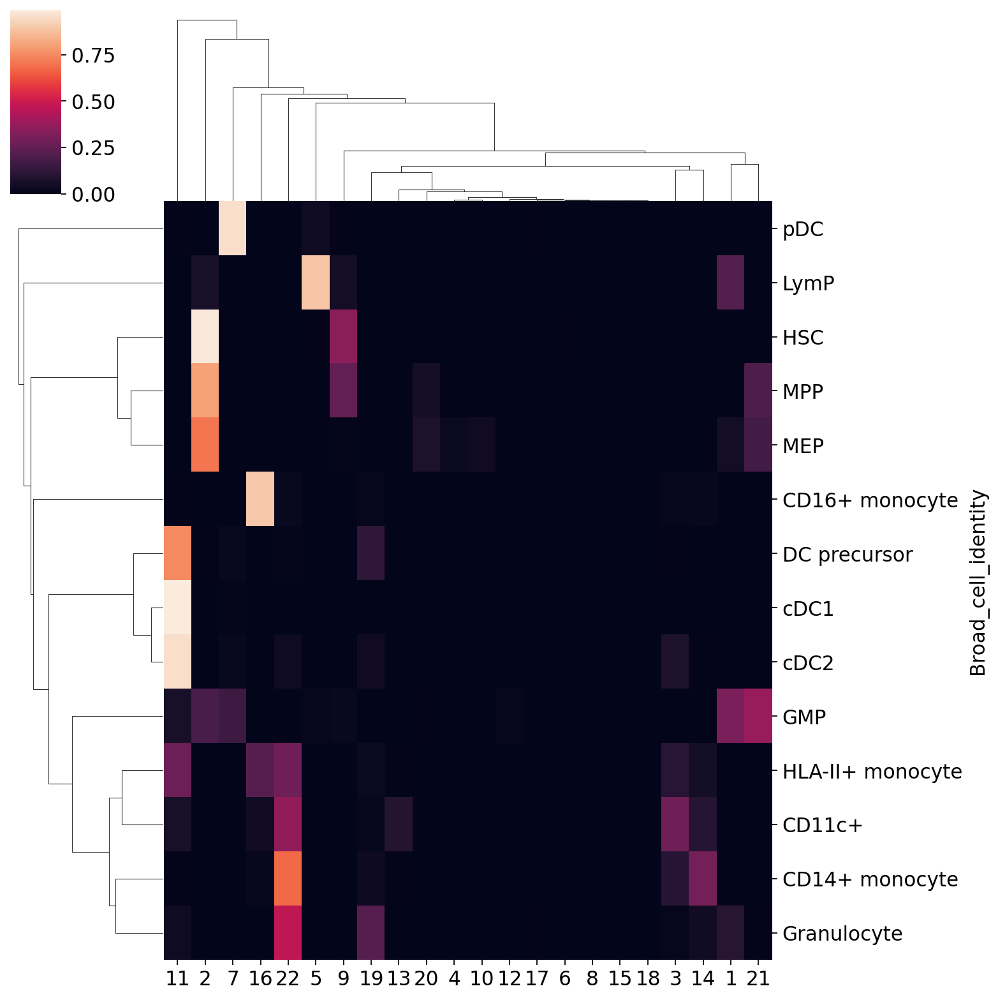

In [28]:
sns.clustermap(usage_by_cluster_Control, xticklabels=True,)


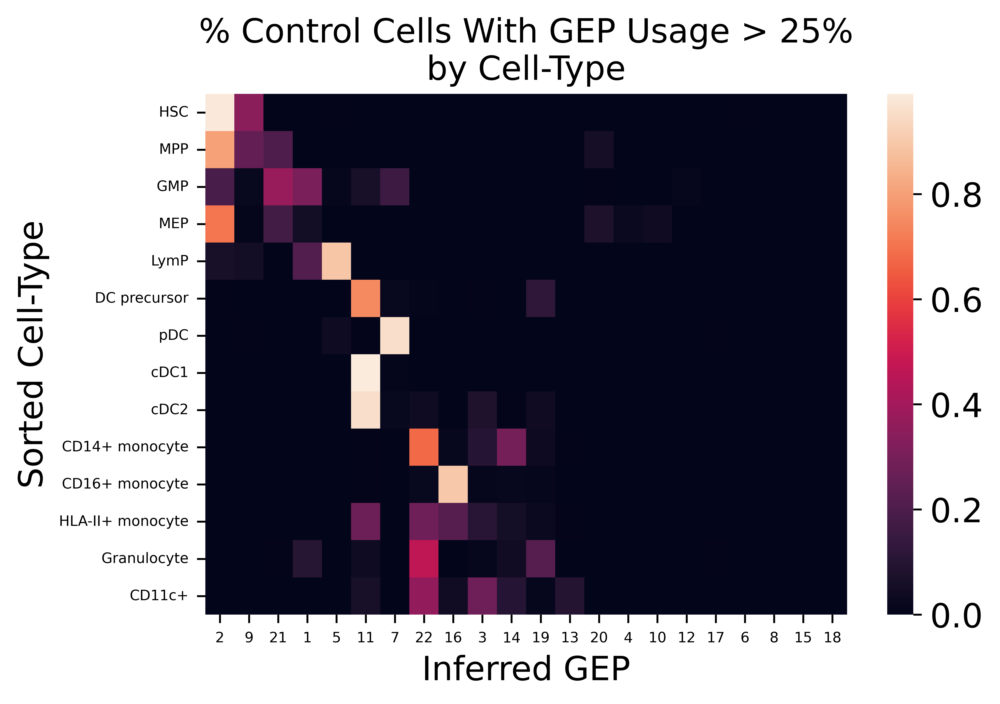

In [21]:
gep_order = [2,9,21,1,5, 11,7,22,16,3,14,19, 13,20,4,10,12,17,6,8,15,18]
usage_by_cluster_Control = usage_by_cluster_Control.loc[cluster_order, gep_order]


(fig,ax) = plt.subplots(1,1,figsize=(6,4), dpi=500)
sns.heatmap(usage_by_cluster_Control, ax=ax)
ax.set_title('% Control Cells With GEP Usage > 25%\nby Cell-Type')
ax.set_ylabel('Sorted Cell-Type')
ax.set_xlabel('Inferred GEP')
ax.set_yticks(np.arange(14)+.5)
ax.set_yticklabels(cluster_order, fontsize=6)

ax.set_xticks(np.arange(22)+.5)
_ = ax.set_xticklabels(gep_order, fontsize=6)

fig.savefig(out_path+"Usage_Control_cells_modules_sorted_k22.pdf", dpi=500)

## Cell type associated GEPs

- HSC - 2
- MPP - 2, 9, 21
- GMP - 21, 1, 2,7 
- MEP - 2,21
- LymP - 5,1
- DC precursor - 11, 19
- pDC - 7
- cDC1 - 11
- cDC2 - 11
- CD14+ monocytes - 22, 14
- CD16+ monocytes - 16
- HLA-II+ monocytes - 11, 22, 16
- Granulocytes - 22,19, 1
- CD11c+ - 22, 3


In [14]:
out_path

'/gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/10-cNMF-adult-pediatric-AML-malignant-control-cells/'

### Adult AML

In [32]:
## Get the % of cells of a cluster that have a >.25 usage of each GEP
usage_by_cluster_AML = normalized_usage_matrix_AML.groupby(adata_obs_AML['Broad_cell_identity'], axis=0).apply(lambda x: (x>.25).mean())

## Order the GEPs to match up to the published clusters
cluster_order = ['HSC', 'MPP', 'GMP','MEP','LymP','DC precursor','pDC', 'cDC1', 'cDC2', 'CD14+ monocyte', 'CD16+ monocyte', 'HLA-II+ monocyte' ,'Granulocyte','CD11c+' ]
gep_order = [2,9,21,1,5, 11,7,22,16,3,14,19, 13,20,4,10,12,17,6,8,15,18]
usage_by_cluster_adult = usage_by_cluster_AML.loc[cluster_order, gep_order]


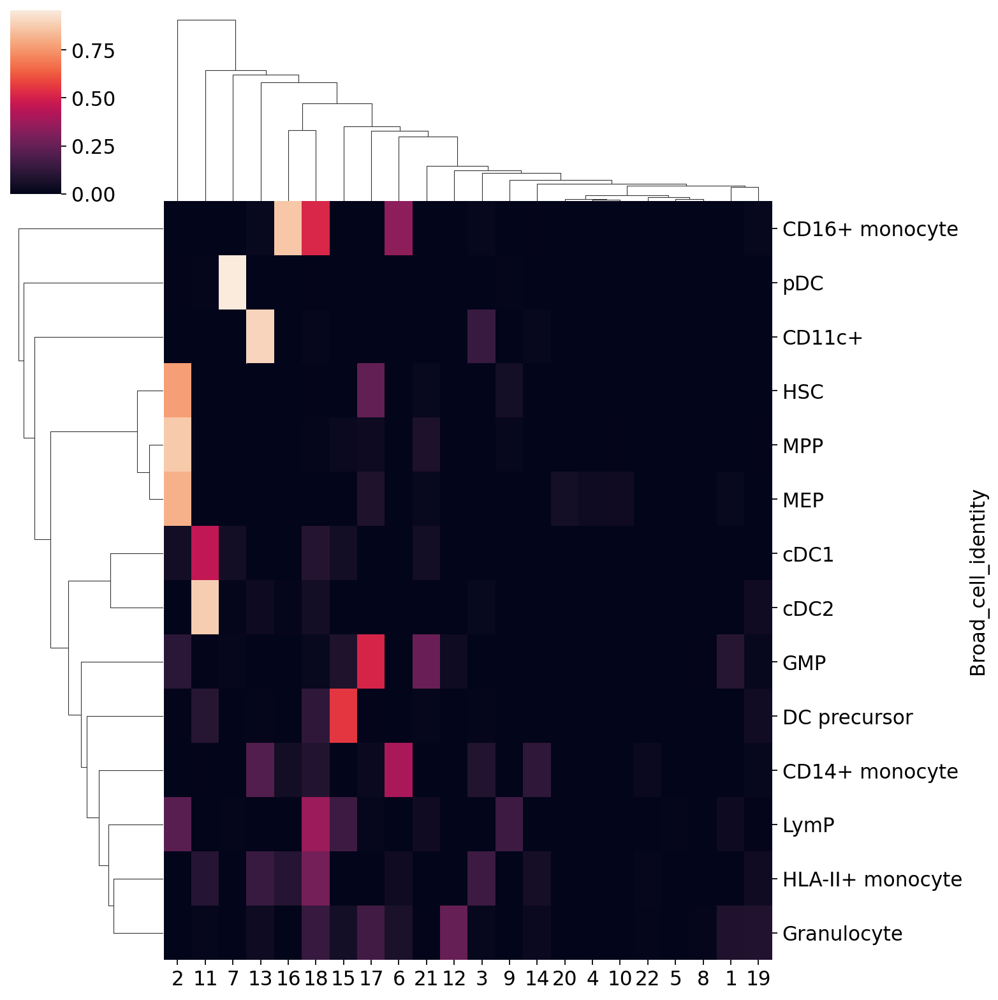

In [33]:
sns.clustermap(usage_by_cluster_AML, xticklabels=True,)


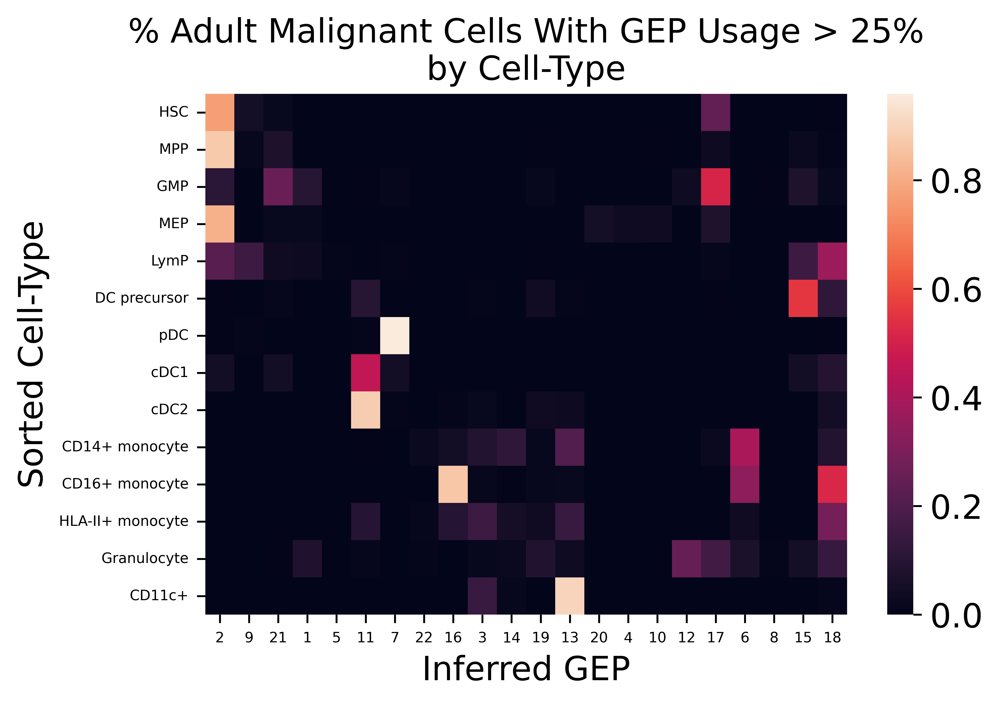

In [34]:
gep_order = [2,9,21,1,5, 11,7,22,16,3,14,19, 13,20,4,10,12,17,6,8,15,18]
usage_by_cluster_AML = usage_by_cluster_AML.loc[cluster_order, gep_order]


(fig,ax) = plt.subplots(1,1,figsize=(6,4), dpi=500)
sns.heatmap(usage_by_cluster_AML, ax=ax)
ax.set_title('% Adult Malignant Cells With GEP Usage > 25%\nby Cell-Type')
ax.set_ylabel('Sorted Cell-Type')
ax.set_xlabel('Inferred GEP')
ax.set_yticks(np.arange(14)+.5)
ax.set_yticklabels(cluster_order, fontsize=6)

ax.set_xticks(np.arange(22)+.5)
_ = ax.set_xticklabels(gep_order, fontsize=6)


### Pediatric AML

In [35]:
## Get the % of cells of a cluster that have a >.25 usage of each GEP
usage_by_cluster_pedAML = normalized_usage_matrix_pedAML.groupby(adata_obs_pedAML['Broad_cell_identity'], axis=0).apply(lambda x: (x>.25).mean())

## Order the GEPs to match up to the published clusters
cluster_order = ['HSC', 'MPP', 'GMP','MEP','LymP','DC precursor','pDC', 'cDC1', 'cDC2', 'CD14+ monocyte', 'CD16+ monocyte', 'HLA-II+ monocyte' ,'Granulocyte','CD11c+' ]
gep_order = [2,9,21,1,5, 11,7,22,16,3,14,19, 13,20,4,10,12,17,6,8,15,18]
usage_by_cluster_pedAML = usage_by_cluster_pedAML.loc[cluster_order, gep_order]


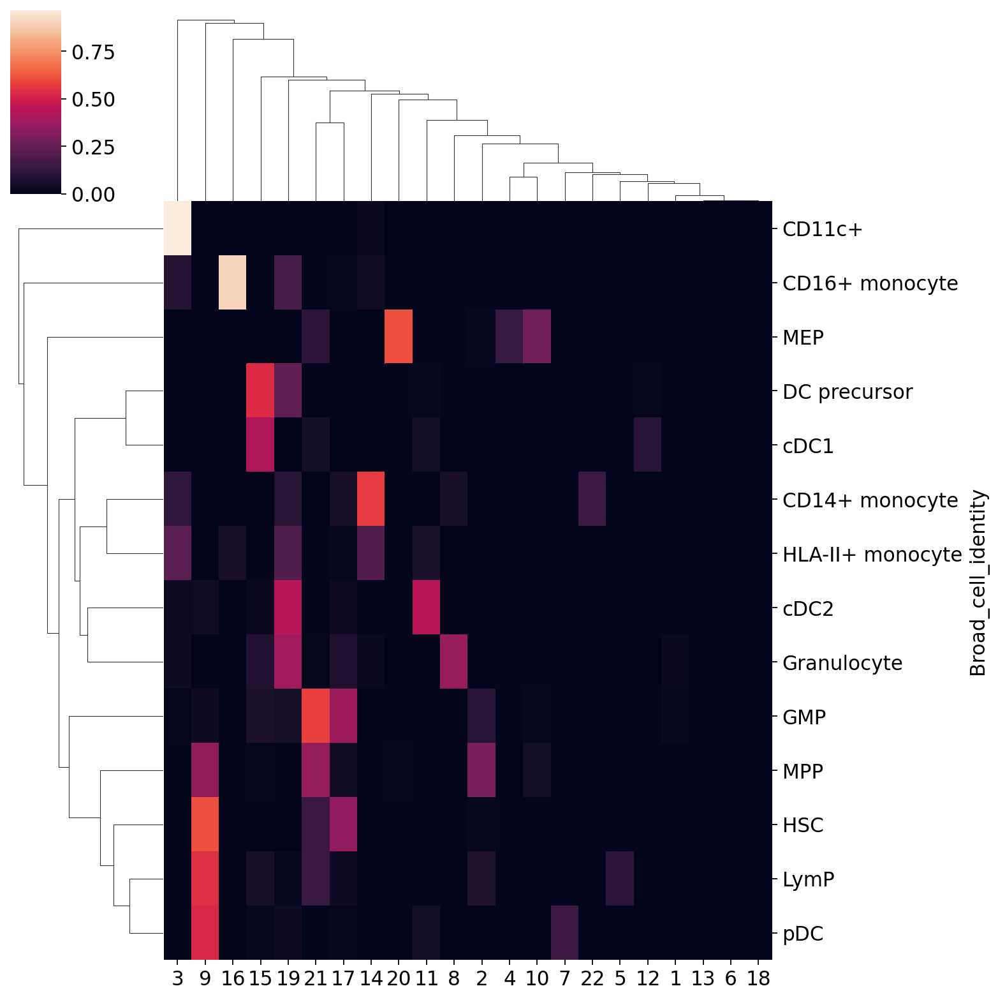

In [36]:
sns.clustermap(usage_by_cluster_pedAML, xticklabels=True,)


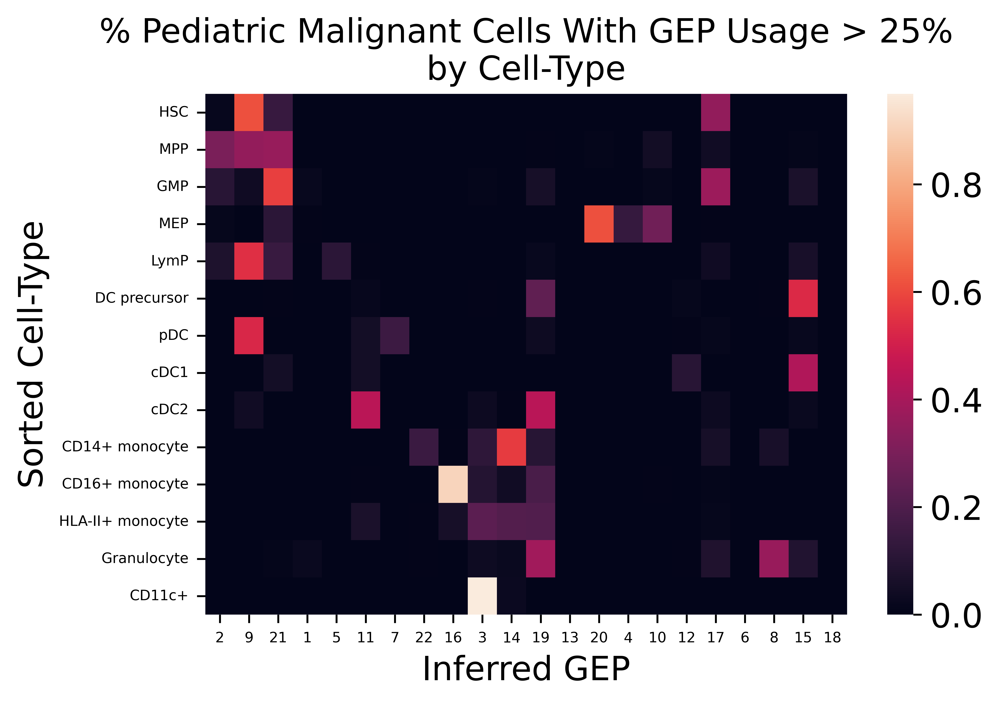

In [37]:
gep_order = [2,9,21,1,5, 11,7,22,16,3,14,19, 13,20,4,10,12,17,6,8,15,18]
usage_by_cluster_pedAML = usage_by_cluster_pedAML.loc[cluster_order, gep_order]


(fig,ax) = plt.subplots(1,1,figsize=(6,4), dpi=500)
sns.heatmap(usage_by_cluster_pedAML, ax=ax)
ax.set_title('% Pediatric Malignant Cells With GEP Usage > 25%\nby Cell-Type')
ax.set_ylabel('Sorted Cell-Type')
ax.set_xlabel('Inferred GEP')
ax.set_yticks(np.arange(14)+.5)
ax.set_yticklabels(cluster_order, fontsize=6)

ax.set_xticks(np.arange(22)+.5)
_ = ax.set_xticklabels(gep_order, fontsize=6)


# Patient GEP association


## Adult and pediatric patients:

In [27]:
# import pprint as pp
import matplotlib
## Get the % of cells of a cluster that have a >.25 usage of each GEP
usage_by_cluster_patient = normalized_usage_matrix_allAML.groupby(adata_obs_allAML['samples'], axis=0).apply(lambda x: (x>.25).mean())

## Order the GEPs to match up to the published clusters
cluster_order = ["AML0024","AML0048","AML0114","AML0160","AML0310","AML0361","AML0612","AML0693","AML1371","AML2123","AML2451","AML2910","AML3050","AML3133","AML3266","AML3730","AML3762","AML3948","AML4340","AML4897","AML001","AML003","AML005","AML006","AML008","AML009","AML012","AML022","AML025","AML026","AML028","AML038","AML043","AML048","AML051","AML052","AML055","AML056","AML073","PAUMTZ","PAWWEE","PAXMIJ"]
usage_by_cluster_patient = usage_by_cluster_patient.loc[cluster_order, gep_order]
usage_by_cluster_patient.head()

,2,9,21,1,5,11,7,22,16,3,...,13,20,4,10,12,17,6,8,15,18
samples,,,,,,,,,,,,,,,,,,,,,
AML0024,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001015,0.145273,0.002706,...,0.000676,0.000000,0.000000,0.000000,0.013699,0.005581,0.981228,0.000338,0.000000,0.000000
AML0048,0.218049,0.001401,0.005045,0.000841,0.000000,0.004204,0.001682,0.004204,0.002522,0.035594,...,0.745235,0.001121,0.004765,0.019899,0.000280,0.001682,0.000561,0.000000,0.000000,0.000000
AML0114,0.964453,0.036483,0.000468,0.000000,0.000468,0.000000,0.000000,0.000000,0.000000,0.000468,...,0.000000,0.030402,0.012161,0.004677,0.000000,0.000000,0.000000,0.000935,0.001403,0.000000
AML0160,0.031023,0.000660,0.000660,0.000000,0.000000,0.004620,0.000000,0.225743,0.000660,0.019802,...,0.000660,0.000000,0.000000,0.000000,0.000000,0.003300,0.000660,0.000000,0.000000,0.005281
AML0310,0.001113,0.000000,0.000000,0.000000,0.000000,0.009568,0.000000,0.004450,0.000000,0.118825,...,0.952158,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [22]:
## load patient metadata for annotation of clustermap
data_path = "/gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/R-cNMF-prep-malignant_control_HSPC_Myeloid/metadata_samples.csv"
meta = pd.read_csv(data_path,index_col=0)
# meta = meta[meta['ap_aml']=='pediatric_AML']


In [23]:
# convert meta to color df:
## This step is necessary because you can't use replace with the tuple rgb values
labels= list(set(np.concatenate([pd.unique(meta[c]) for c in meta.columns])))
del labels[0]
print(labels)

['RUNX1', 'MLLr', 'Adverse', 'Inflammation_high', 'infants', 'TET2', 'Inflammation_low', 'Favorable', 'CBF', 'pediatric_NA', 'DNMT3A', 'adult_younger60', 'IDH1', 'teens', 'IDH2', 'pediatric_AML', 'adult_AML', 'children', 'Intermediate', 'high', 'adult_60up', 'male', 'female', 'TP53', 'intermediate', 'low', 'NPM1']


In [25]:

lut = dict(zip(set(labels), sns.color_palette("magma", n_colors=len(set(labels)))))
lut = {k:matplotlib.colors.to_hex(v) for k, v in lut.items()}
annotations_df = meta.replace(lut)

annotations_df = annotations_df.dropna(axis=1,how='all')

annotations_df.head()

,ap_aml,gender,age_group,inflammation_group,risk,risk_adult,TP53,RUNX1,NPM1,CBF,DNMT3A,MLL,TET2,IDH1,IDH2
samples,,,,,,,,,,,,,,,
AML0612,#e04c67,#feaa74,#fc8961,#51127c,NaN,#160f3b,#febb81,#040414,NaN,NaN,NaN,NaN,NaN,#a6317d,NaN
AML3762,#e04c67,#fd9a6a,#fc8961,#51127c,NaN,#160f3b,NaN,#040414,NaN,NaN,NaN,NaN,NaN,#a6317d,#c53c74
AML0160,#e04c67,#fd9a6a,#fc8961,#51127c,NaN,#160f3b,NaN,#040414,NaN,NaN,NaN,NaN,#400f74,NaN,NaN
AML0310,#e04c67,#fd9a6a,#fc8961,#51127c,NaN,#f3655c,NaN,NaN,NaN,NaN,NaN,NaN,#400f74,NaN,NaN
AML3133,#e04c67,#fd9a6a,#982d80,#51127c,NaN,#5f187f,NaN,NaN,#fcecae,NaN,#892881,NaN,NaN,#a6317d,NaN


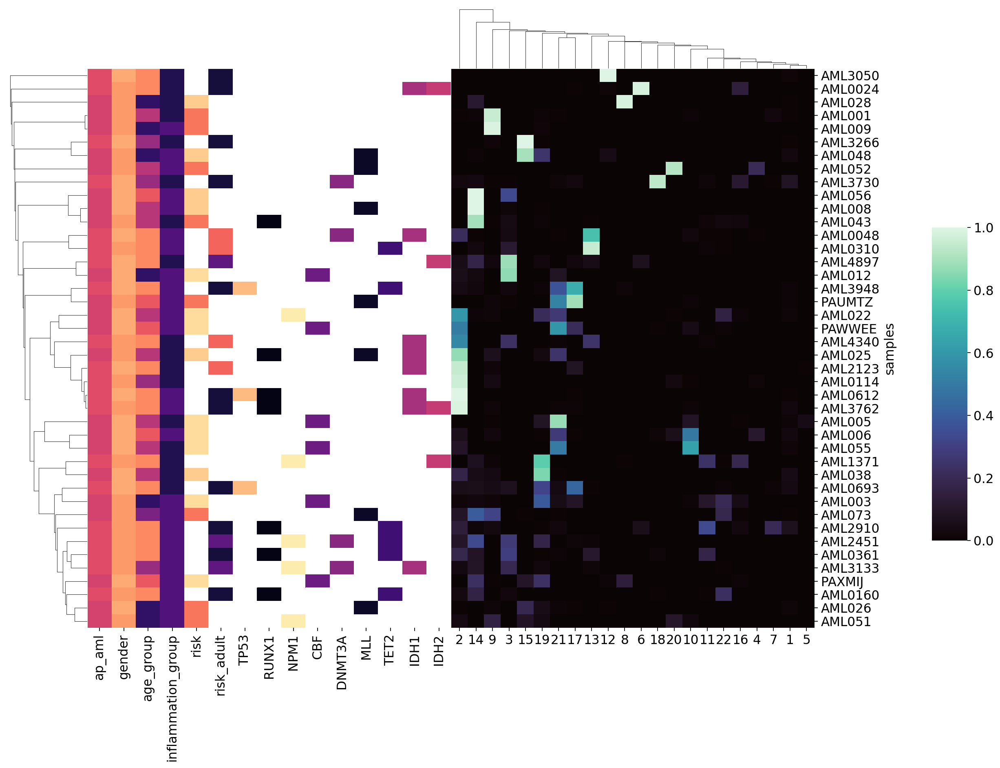

In [28]:
# sns.clustermap(usage_by_cluster_patient,yticklabels=True, cmap="mako",row_colors=annotations_df)
# with rc_context({'figure.figsize': (10, 12)}):

g = sns.clustermap(usage_by_cluster_patient,yticklabels=True, xticklabels=True,cmap="mako",row_colors=annotations_df,  figsize=(18, 12),dendrogram_ratio=0.1,)
g.fig.subplots_adjust(right=0.7)
g.ax_cbar.set_position((0.8, .3, .03, .4))

g.savefig(out_path+"Usage_AML_modules_k22_mut_associations.pdf", dpi=500)


## Inflammation cluster association:

## Adult patients

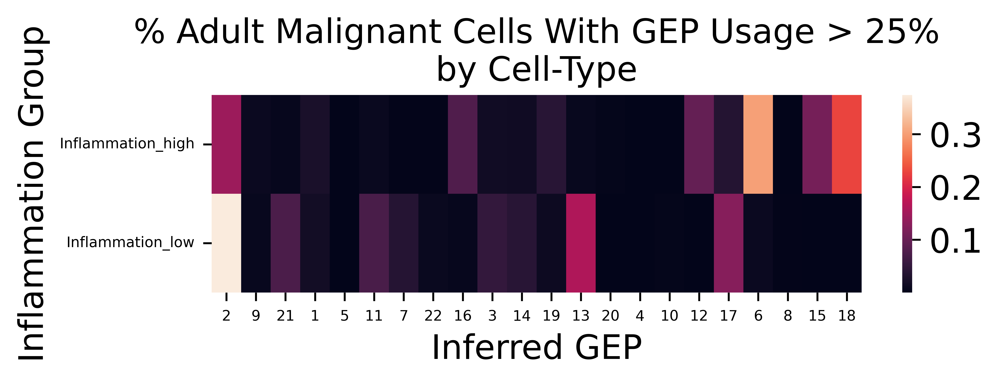

In [66]:
# Get the % of cells of a cluster that have a >.25 usage of each GEP
usage_by_cluster_AML = normalized_usage_matrix_AML.groupby(adata_obs_AML['inflammation_group'], axis=0).apply(lambda x: (x>.25).mean())

## Order the GEPs to match up to the published clusters
cluster_order = ['Inflammation_high', 'Inflammation_low' ]

gep_order = [2,9,21,1,5, 11,7,22,16,3,14,19, 13,20,4,10,12,17,6,8,15,18]
usage_by_cluster_AML = usage_by_cluster_AML.loc[cluster_order, gep_order]


(fig,ax) = plt.subplots(1,1,figsize=(6,1.5), dpi=500)
sns.heatmap(usage_by_cluster_AML, ax=ax)
ax.set_title('% Adult Malignant Cells With GEP Usage > 25%\nby Cell-Type')
ax.set_ylabel('Inflammation Group')
ax.set_xlabel('Inferred GEP')
ax.set_yticks(np.arange(2)+.5)
ax.set_yticklabels(cluster_order, fontsize=6)

ax.set_xticks(np.arange(22)+.5)
_ = ax.set_xticklabels(gep_order, fontsize=6)


In [70]:
## Load the Z-scored GEPs which reflect how enriched a gene is in each GEP relative to all of the others
gene_scores = pd.read_csv(out_path+'/'+run_name+'/'+run_name+'.gene_spectra_score.k_%d.dt_%s.txt' % (selected_K, density_threshold_str),
                    sep='\t', index_col=0).T
gene_scores.head()

,1,2,3,4,5,6,7,8,9,10,...,13,14,15,16,17,18,19,20,21,22
AL627309.1,-0.000008,-0.000086,-0.000052,-0.000018,0.000054,-0.000035,-0.000026,0.000025,-5.082121e-07,-0.000009,...,0.000050,0.000006,0.000129,0.000029,0.000075,-0.000085,1.636213e-04,0.000003,-0.000071,-0.000006
AL627309.5,-0.000072,-0.000168,0.000099,-0.000171,-0.000081,-0.000125,-0.000084,0.000625,-3.446171e-05,-0.000099,...,-0.000106,0.000501,-0.000039,-0.000017,-0.000093,-0.000240,2.959719e-04,-0.000112,-0.000176,0.000097
LINC01409,-0.000071,-0.000124,-0.000128,-0.000153,0.000159,-0.000173,0.000446,-0.000109,3.434574e-04,0.000187,...,-0.000247,0.000113,0.000765,-0.000090,-0.000070,0.000086,7.350635e-05,-0.000105,-0.000190,-0.000109
LINC01128,-0.000271,-0.000300,0.000272,0.000102,0.001122,-0.000108,0.000139,0.000189,4.337843e-05,0.000225,...,0.000010,-0.000077,0.000148,-0.000129,0.000157,-0.000114,-1.750095e-04,0.000088,0.000190,-0.000298
LINC00115,-0.000091,0.000003,-0.000044,-0.000054,0.000051,-0.000059,0.000004,-0.000016,1.125034e-04,-0.000031,...,0.000135,0.000021,-0.000048,0.000102,0.000011,-0.000117,5.101350e-07,0.000001,-0.000050,-0.000005


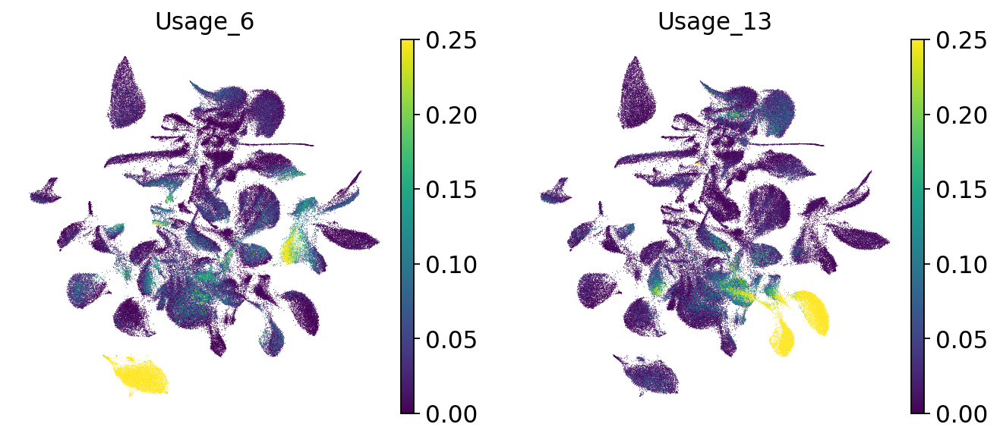

In [38]:
sc.pl.umap(adata, color=['Usage_6', 'Usage_13'],
           use_raw=True, ncols=2, vmax=0.25, save="_inflammation_features_k22_adult_peds.pdf")


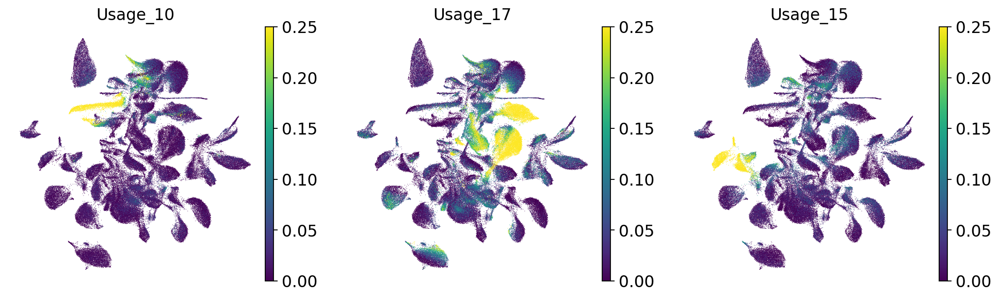

In [39]:
sc.pl.umap(adata, color=['Usage_10', 'Usage_17','Usage_15'],
           use_raw=True, ncols=3, vmax=0.25, save="_Splicing_features_k22_adult_peds.pdf")


## The top expressed genes can be used for GO analysis 
Plot some cell cycle markers

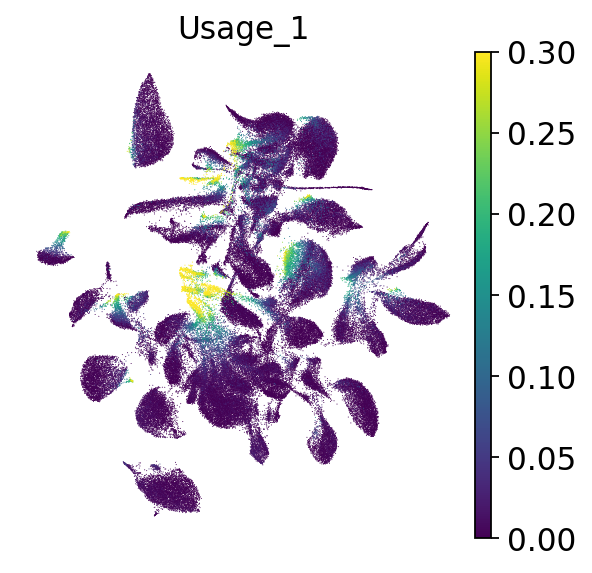

In [43]:
sc.pl.umap(adata, color=['Usage_1'],
           use_raw=True, ncols=1, vmax=0.3, save="_cycling_feature_k22_adult_peds.pdf")


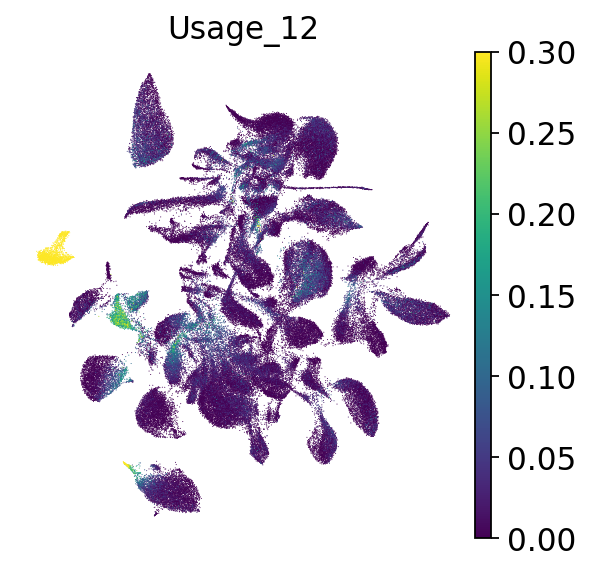

In [5]:
sc.pl.umap(adata, color=['Usage_12'],
           use_raw=True, ncols=1, vmax=0.3, save="_ribo_metabolism_feature_k22_adult_peds.pdf")


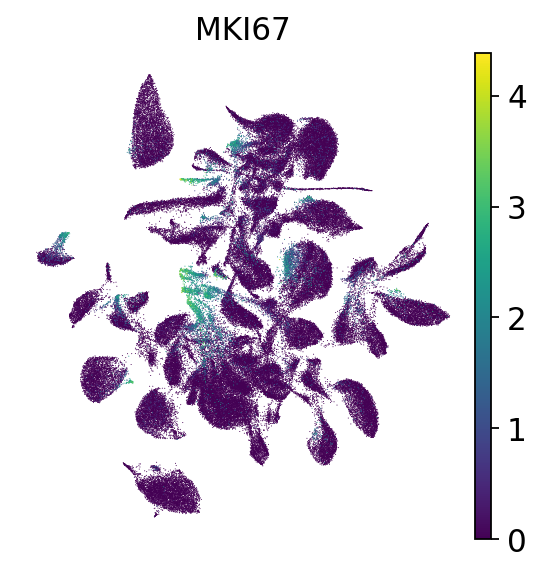

In [47]:
sc.pl.umap(adata, color=['MKI67'],
           use_raw=True, ncols=1, save="_MKI67_adult_peds.pdf")


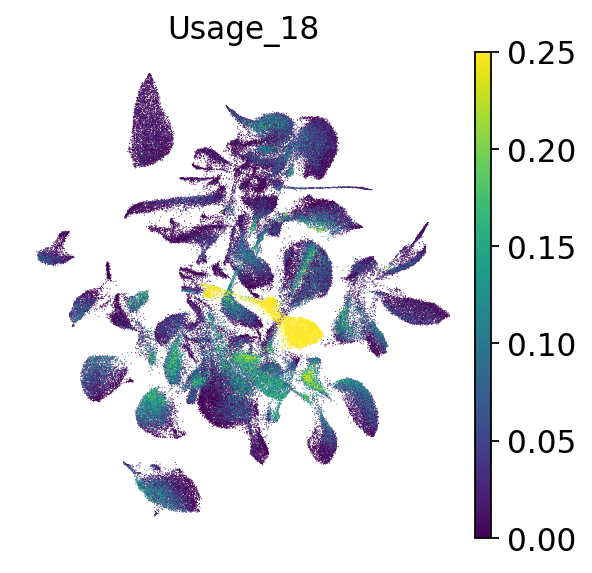

In [44]:
sc.pl.umap(adata, color=['Usage_18'],
           use_raw=True, ncols=1, vmax=0.25, save="_unfolded_protein_response_feature_k22_adult_peds.pdf")


# GO analysis

We want to check several different MSigDB gene sets:
- C5: GO (c5.go.bp.v7.5.1.symbols.gmt, c5.go.cc.v7.5.1.symbols.gmt, c5.go.mf.v7.5.1.symbols.gmt)
    - C7: ImmuneSigDB (c7.immunesigdb.v7.5.1.symbols.gmt)
    - C6: oncogenic signature gene sets (c6.all.v7.5.1.symbols.gmt)
    - C1: positional gene sets - may help identifying programs related to chromosomal abarrations (c1.all.v7.5.1.symbols.gmt)

## GO gene sets - C5

In [76]:
import sys
sys.path.append('/gpfs/data/aifantislab/home/nadorb01/common_scripts/')
from test_genesets import load_genesets, mann_whitney_test_per_gep

gmt_file_path='/gpfs/data/aifantislab/home/nadorb01/Common_data/MSigDB_gmt_files/'
bp='c5.go.bp.v7.5.1.symbols.gmt'
mf='c5.go.mf.v7.5.1.symbols.gmt'
cc='c5.go.cc.v7.5.1.symbols.gmt'

In [77]:
genescores_labeled_totest = gene_scores.copy()
genescores_labeled_totest.index = [x.upper() for x in genescores_labeled_totest.index]
genescores_labeled_totest.head()

geneset_fn = gmt_file_path+bp
(go_set, setgenes) = load_genesets(geneset_fn, genes=genescores_labeled_totest.index, minsize=20)

genescores_labeled_totest = genescores_labeled_totest.loc[setgenes, :]
ngenes = len(setgenes)
print('%d genes used for geneset testing as they are both in the in geneset file and our gene scores' % ngenes)


## We set a floor on the gene scores of 0 because we are only looking for genes that are
## over-active in a GEP relative to average
for i in genescores_labeled_totest.columns:
    genescores_labeled_totest.loc[genescores_labeled_totest[i]<0, i]=0
    
go_annotation_results = mann_whitney_test_per_gep(go_set, genescores_labeled_totest)

go_annotation_results.to_csv(out_path+'GO_biological_pathways_GEP_association_k22.csv')

11917 genes used for geneset testing as they are both in the in geneset file and our gene scores
0 out of 3117 genesets completed
100 out of 3117 genesets completed
200 out of 3117 genesets completed
300 out of 3117 genesets completed
400 out of 3117 genesets completed
500 out of 3117 genesets completed
600 out of 3117 genesets completed
700 out of 3117 genesets completed
800 out of 3117 genesets completed
900 out of 3117 genesets completed
1000 out of 3117 genesets completed
1100 out of 3117 genesets completed
1200 out of 3117 genesets completed
1300 out of 3117 genesets completed
1400 out of 3117 genesets completed
1500 out of 3117 genesets completed
1600 out of 3117 genesets completed
1700 out of 3117 genesets completed
1800 out of 3117 genesets completed
1900 out of 3117 genesets completed
2000 out of 3117 genesets completed
2100 out of 3117 genesets completed
2200 out of 3117 genesets completed
2300 out of 3117 genesets completed
2400 out of 3117 genesets completed
2500 out of 311

In [78]:
go_annotation_results.sort_values(by=1, ascending=True).head(20)

,1,2,3,4,5,6,7,8,9,10,...,13,14,15,16,17,18,19,20,21,22
GOBP_CELL_CYCLE,5.49022e-71,0.854853,0.638213,0.761564,3.33026e-13,0.999961,0.714972,0.00679433,6.09834e-12,0.708867,...,0.772009,0.835091,0.000243356,0.988715,2.24604e-07,0.999996,0.0585138,0.998497,0.941822,1
GOBP_CELL_CYCLE_PROCESS,1.98147e-66,0.891084,0.991271,0.928112,2.03214e-11,0.999993,0.0683525,0.20806,3.208e-12,0.992797,...,0.987598,0.976443,0.000925603,0.999797,2.49277e-06,1,0.018565,0.999258,0.944666,1
GOBP_MITOTIC_CELL_CYCLE,5.93792e-61,0.924989,0.827196,0.86532,8.91398e-09,0.996665,0.157196,0.26659,6.43812e-07,0.763123,...,0.634922,0.929316,0.241037,0.985817,5.57504e-07,0.999598,0.158513,0.999276,0.929608,0.999999
GOBP_CHROMOSOME_ORGANIZATION,8.76547e-61,0.84187,0.999996,0.677794,3.10273e-30,1,0.0020746,0.00782343,2.53594e-43,0.574588,...,1,0.385338,3.7714e-10,1,5.42833e-10,1,1.81202e-12,0.864354,0.000164992,1
GOBP_MITOTIC_CELL_CYCLE_PROCESS,2.95104e-58,0.851867,0.941851,0.863035,4.0223e-10,0.999076,0.0291154,0.421802,8.89455e-07,0.928524,...,0.770876,0.94753,0.377908,0.975547,1.8856e-06,0.999477,0.164417,0.999438,0.922194,1
GOBP_CHROMOSOME_SEGREGATION,7.05843e-53,0.996726,0.998781,0.930866,4.48781e-18,0.999949,0.0396939,0.495755,0.000266759,0.999925,...,0.999944,0.975811,0.101646,0.997979,0.0197029,0.999987,0.0399993,0.999422,0.653707,0.999901
GOBP_NUCLEAR_CHROMOSOME_SEGREGATION,2.68172e-49,0.995573,0.999179,0.898018,8.29564e-18,0.99997,0.143753,0.60135,0.00088542,0.999692,...,0.999917,0.981663,0.0895555,0.977618,0.0724822,0.999989,0.077758,0.999288,0.940944,0.999644
GOBP_CELL_DIVISION,1.23719e-46,0.900332,0.936866,0.343938,7.95832e-08,0.999256,0.291713,0.743376,0.00384909,0.724483,...,0.51821,0.774255,0.378926,0.981057,0.0907498,0.999897,0.586242,0.945077,0.975236,0.999925
GOBP_DNA_METABOLIC_PROCESS,2.43443e-45,0.673769,0.999999,0.216661,8.30906e-18,0.999992,0.00245526,0.790757,1.36786e-22,0.999907,...,0.999994,0.999973,0.0145718,0.980294,5.65507e-08,0.999996,3.23098e-05,0.452984,5.10509e-13,0.999982
GOBP_ORGANELLE_FISSION,7.21964e-45,0.994508,0.999724,0.554329,2.50457e-10,0.999353,0.393381,0.40767,0.0620423,0.99947,...,0.998583,0.98411,0.225354,0.974195,0.00483398,0.999991,0.315435,0.99036,0.940511,0.999986


In [84]:
go_annotation_results.sort_values(by=6, ascending=True).head(25)

,1,2,3,4,5,6,7,8,9,10,...,13,14,15,16,17,18,19,20,21,22
GOBP_BIOLOGICAL_PROCESS_INVOLVED_IN_INTERSPECIES_INTERACTION_BETWEEN_ORGANISMS,0.595366,1,1.93676e-24,1,1,3.78978e-28,0.907835,0.485149,1,0.999753,...,3.96211e-11,3.91908e-19,1,1.22817e-26,0.171842,0.0906344,0.882084,1,0.999947,1.46434e-05
GOBP_DEFENSE_RESPONSE_TO_OTHER_ORGANISM,0.843685,1,6.88881e-17,1,1,4.33407e-24,0.895828,0.0778949,1,0.999999,...,9.01795e-05,1.51318e-15,1,3.86389e-26,0.584127,0.382714,0.0287367,1,0.999802,1.53059e-08
GOBP_DEFENSE_RESPONSE,0.995663,1,3.46853e-29,1,1,6.17071e-24,0.997841,0.700497,1,0.999999,...,1.25953e-09,2.44797e-19,1,3.03618e-28,0.350834,0.173374,0.653854,1,1,2.82561e-08
GOBP_INNATE_IMMUNE_RESPONSE,0.600727,0.999999,3.33936e-15,1,0.999993,1.72111e-23,0.981988,0.0832765,1,1,...,0.00110909,8.36811e-13,1,8.77177e-22,0.528928,0.323145,0.242219,1,0.999474,4.55188e-07
GOBP_IMMUNE_RESPONSE,0.999507,1,5.62735e-24,1,0.999997,6.81849e-21,0.911326,0.584959,1,1,...,5.63577e-09,2.53793e-16,1,1.29052e-31,0.378214,0.153056,0.723097,1,1,1.71178e-08
GOBP_RESPONSE_TO_BACTERIUM,0.963197,1,1.4365e-18,1,1,1.28878e-19,0.991853,0.97717,1,0.998329,...,1.26783e-06,8.15769e-07,1,8.86556e-11,0.0987537,0.609944,0.999929,1,0.999995,0.00285683
GOBP_RESPONSE_TO_VIRUS,0.112865,0.999469,0.027123,0.995187,0.968382,8.17581e-19,0.00449162,0.351239,0.88862,0.97517,...,0.627162,0.00132771,0.999228,7.41798e-17,0.404859,0.695201,0.00156962,0.986149,0.0129126,0.0655391
GOBP_DEFENSE_RESPONSE_TO_SYMBIONT,0.187205,0.999716,0.12869,0.997201,0.865946,6.85043e-18,0.00380177,0.354081,0.514271,0.975992,...,0.922687,0.0115608,0.992718,4.25249e-20,0.597384,0.940411,0.000401672,0.983686,0.0140303,0.0445787
GOBP_RESPIRATORY_ELECTRON_TRANSPORT_CHAIN,3.52197e-14,0.0568443,0.944452,4.7246e-12,0.89972,1.87486e-17,0.487674,0.991966,1,0.994761,...,0.716795,0.991544,0.306767,5.47125e-09,0.999931,0.11304,0.824906,5.26546e-08,9.3677e-25,7.18948e-20
GOBP_ELECTRON_TRANSPORT_CHAIN,2.98072e-14,0.352834,0.959016,8.42498e-09,0.86639,8.1931e-17,0.469517,0.991785,1,0.986155,...,0.683948,0.915349,0.776522,1.07286e-09,0.999976,0.0752326,0.884861,1.96639e-05,5.4092e-20,8.61092e-21


In [89]:
go_annotation_results.sort_values(by=10, ascending=True).head(20)

,1,2,3,4,5,6,7,8,9,10,...,13,14,15,16,17,18,19,20,21,22
GOBP_POSITIVE_REGULATION_OF_RNA_METABOLIC_PROCESS,0.972139,0.0367009,8.50215e-08,0.99979,3.70105e-07,0.999837,0.26027,0.0035909,1.33832e-10,2.52342e-10,...,0.0006492,3.53975e-05,0.0205023,0.756838,7.18159e-08,0.0449432,0.0154603,0.99551,1,0.999963
GOBP_POSITIVE_REGULATION_OF_NUCLEOBASE_CONTAINING_COMPOUND_METABOLIC_PROCESS,0.449019,0.0107822,1.5915e-06,0.998017,4.60447e-09,0.999827,0.410437,0.00156419,1.02932e-12,4.30033e-10,...,0.00534054,0.000780683,0.0234535,0.736664,1.96642e-08,0.119429,0.00565879,0.99332,1,0.99999
GOBP_MRNA_PROCESSING,9.60133e-26,1.53946e-10,0.747151,3.25093e-05,3.98972e-16,0.999995,5.19879e-19,4.33065e-07,1.25096e-17,4.87154e-09,...,0.999957,0.000328732,5.87933e-14,0.99899,9.40476e-08,0.00701448,0.00126216,5.57507e-05,0.00323558,0.99995
GOBP_REGULATION_OF_MRNA_PROCESSING,9.06299e-06,0.000170125,0.00472924,0.789143,2.64562e-07,0.999781,0.00289922,1.40465e-07,2.32831e-09,5.7175e-09,...,0.814328,0.000132706,3.99852e-05,0.998766,1.19978e-07,0.192168,0.0232634,0.742611,0.503737,0.999866
GOBP_POSITIVE_REGULATION_OF_TRANSCRIPTION_BY_RNA_POLYMERASE_II,0.999999,0.0347212,2.23981e-06,0.999992,0.00254638,0.997294,0.844806,0.109655,6.90663e-06,2.06731e-08,...,8.80737e-05,0.000224564,0.432023,0.859878,1.20024e-05,0.10381,0.183009,0.999935,1,0.999275
GOBP_RNA_SPLICING,5.79964e-26,6.0763e-11,0.863773,0.00018953,5.53089e-15,0.991383,8.35424e-19,0.000430898,3.68871e-12,5.25763e-08,...,0.999803,0.00152937,2.10517e-09,0.993979,4.38287e-09,0.000514425,0.0277497,0.000138704,0.00401685,0.99957
GOBP_POSITIVE_REGULATION_OF_CELLULAR_BIOSYNTHETIC_PROCESS,0.79603,0.0309122,1.24172e-06,0.998725,9.95028e-05,0.999142,0.732825,0.0293232,3.32824e-06,5.62397e-08,...,8.41538e-05,0.00167962,0.0244368,0.939242,1.63855e-05,0.0613393,0.0340151,0.996331,0.999997,0.999537
GOBP_REGULATION_OF_MRNA_SPLICING_VIA_SPLICEOSOME,7.51007e-05,1.91167e-06,0.0195568,0.920136,6.59179e-06,0.992808,0.00915023,0.000120609,2.02e-05,2.19869e-07,...,0.720307,0.0143394,0.000134131,0.997497,5.6483e-08,0.0896838,0.325798,0.881436,0.455491,0.999653
GOBP_NEGATIVE_REGULATION_OF_NUCLEOBASE_CONTAINING_COMPOUND_METABOLIC_PROCESS,0.999176,0.0794129,8.14567e-05,0.999987,2.56898e-12,0.997008,0.302176,0.087855,8.24007e-17,3.80479e-07,...,0.0193196,0.0142184,7.30735e-08,0.966827,2.31578e-05,6.32053e-06,0.151599,0.999691,0.999994,1
GOBP_RNA_SPLICING_VIA_TRANSESTERIFICATION_REACTIONS,5.70533e-26,1.22926e-09,0.887185,0.000156168,1.0428e-13,0.987506,3.91381e-13,0.00130408,5.74829e-09,4.5191e-07,...,0.999091,0.0465852,1.54234e-06,0.98829,5.55799e-07,0.00635646,0.123687,9.58217e-05,0.000141473,0.999229


In [91]:
go_annotation_results.sort_values(by=12, ascending=True).head(20)

,1,2,3,4,5,6,7,8,9,10,...,13,14,15,16,17,18,19,20,21,22
GOBP_RIBOSOME_BIOGENESIS,4.76489e-11,1.61318e-05,0.999984,8.72286e-06,0.0254614,0.999974,1.3971e-17,0.999996,0.182763,0.997654,...,0.999971,1,3.73157e-08,0.987129,0.00904537,5.27719e-05,0.714596,1.56015e-29,1.68174e-66,0.996174
GOBP_RIBONUCLEOPROTEIN_COMPLEX_BIOGENESIS,2.55651e-15,5.72249e-10,0.999735,1.65324e-07,0.00114756,1,3.96209e-19,0.999718,0.00138801,0.921867,...,0.999999,1,4.90295e-12,0.998457,0.000826383,3.05941e-05,0.208735,6.57551e-28,1.11877e-63,0.999551
GOBP_NCRNA_METABOLIC_PROCESS,1.10638e-10,0.170878,0.999996,7.4082e-06,2.54184e-05,0.999999,3.762e-17,0.99988,1.48938e-06,0.999099,...,1,1,7.03104e-08,0.998362,0.00236539,0.144312,0.0131008,1.86005e-25,8.60797e-53,0.999669
GOBP_NCRNA_PROCESSING,3.82355e-09,0.021977,0.999921,3.95856e-07,0.000316309,0.999994,2.42241e-18,0.999993,0.000132937,0.998401,...,1,1,1.08087e-05,0.974166,0.00726362,0.0324123,0.104443,1.31661e-28,1.03901e-53,0.997271
GOBP_RRNA_METABOLIC_PROCESS,1.50493e-11,0.000734258,0.99987,5.76642e-05,0.00531481,0.999993,7.31154e-13,0.999959,0.0522354,0.993381,...,0.999949,1,5.36807e-07,0.983068,0.0108582,0.0246933,0.602471,2.51468e-22,1.44119e-52,0.994071
GOBP_AEROBIC_RESPIRATION,4.38878e-21,0.00419825,0.964728,8.06368e-16,0.746112,2.1451e-12,0.547497,0.963489,1,0.958615,...,0.919302,0.993754,0.075077,2.8498e-09,0.999996,0.0695958,0.365874,2.29353e-09,5.688e-35,3.04463e-21
GOBP_CELLULAR_MACROMOLECULE_BIOSYNTHETIC_PROCESS,9.671e-20,5.4412e-12,0.999686,0.0356128,0.00757345,0.999165,8.93169e-10,0.966209,0.0398372,0.982923,...,0.999707,1,2.62009e-05,0.999867,0.00124203,1.99682e-09,0.00768207,5.19521e-07,6.00066e-48,0.985867
GOBP_RNA_PROCESSING,5.90997e-28,3.0382e-10,0.996002,7.85738e-08,1.41256e-17,1,1.28588e-32,0.16869,5.9034e-20,0.00994751,...,1,0.978995,2.11156e-18,0.999932,1.22222e-09,0.000300878,0.000694115,1.76759e-21,4.45487e-32,1
GOBP_CELLULAR_RESPIRATION,1.5221e-18,0.0145369,0.973484,1.59919e-13,0.730018,2.36525e-13,0.628913,0.980713,1,0.992108,...,0.774361,0.994434,0.252216,2.13416e-08,0.999996,0.14125,0.197145,5.77917e-09,4.00269e-32,1.16144e-19
GOBP_PEPTIDE_BIOSYNTHETIC_PROCESS,0.000266714,1.61026e-22,0.943394,0.153129,0.00536035,0.916563,1.02594e-06,0.981391,0.979053,0.955297,...,0.926677,0.999998,5.42372e-09,0.997132,0.0298171,3.60609e-25,0.371974,1.46421e-09,6.74949e-54,0.224983


In [92]:
go_annotation_results.sort_values(by=13, ascending=True).head(20)

,1,2,3,4,5,6,7,8,9,10,...,13,14,15,16,17,18,19,20,21,22
GOBP_REGULATION_OF_CELL_DEATH,0.404014,0.76743,8.35949e-21,0.974535,0.999682,0.000806965,0.997373,0.907961,1,0.0326928,...,2.49565e-21,5.26205e-07,1,0.00159282,0.00532245,0.154692,0.998146,0.999995,0.999978,0.0115388
GOBP_REGULATION_OF_INTRACELLULAR_SIGNAL_TRANSDUCTION,0.999679,0.999241,8.15301e-20,0.999998,0.997504,0.148196,0.936512,0.54765,0.745574,0.175637,...,1.89354e-19,1.54989e-11,1,1.33304e-07,0.507745,0.245315,0.791325,1,1,0.139791
GOBP_POSITIVE_REGULATION_OF_SIGNALING,1,0.986249,2.81171e-16,1,0.999983,0.00462084,0.999998,0.790346,0.999491,0.221648,...,7.59342e-19,7.46473e-08,1,1.04641e-06,0.736288,0.124695,0.997761,1,1,0.0234193
GOBP_PROGRAMMED_CELL_DEATH,0.0882696,0.844182,1.35344e-17,0.993156,0.962396,4.1664e-05,0.974586,0.391185,0.999996,0.0685789,...,3.11138e-16,2.25035e-07,0.999988,1.20939e-05,0.00895075,0.113148,0.949799,1,0.999249,0.0120142
GOBP_REGULATION_OF_CELLULAR_COMPONENT_MOVEMENT,0.999992,0.997881,1.45643e-17,0.99981,0.999997,0.00567499,1,0.943188,0.999937,0.780542,...,5.16393e-16,0.00444143,1,0.00306706,0.526891,0.944298,0.999998,1,1,0.831379
GOBP_POSITIVE_REGULATION_OF_INTRACELLULAR_SIGNAL_TRANSDUCTION,0.999904,0.949706,5.72931e-15,0.999987,0.999973,0.0130939,0.996183,0.966747,0.999556,0.462578,...,6.06544e-16,3.691e-06,1,1.3028e-07,0.630808,0.193161,0.96794,1,1,0.0982467
GOBP_CELL_MIGRATION,0.999999,0.99848,1.70407e-18,1,1,0.00152682,1,0.889507,0.999987,0.825272,...,3.67516e-15,2.4855e-05,1,0.00307153,0.651813,0.991161,0.999994,1,1,0.502191
GOBP_REGULATION_OF_CELL_POPULATION_PROLIFERATION,0.996151,0.964042,1.79653e-17,0.999999,0.999948,0.00125903,1,0.972632,1,0.202535,...,3.7628e-14,0.0511905,1,0.0464512,0.359898,0.0592172,1,1,1,0.923828
GOBP_REGULATION_OF_PHOSPHORUS_METABOLIC_PROCESS,0.914124,0.999998,6.87699e-14,0.985768,0.999973,0.216937,0.996851,0.224105,0.990232,0.0203636,...,5.92992e-14,2.86886e-10,0.999918,0.000714378,0.162813,0.494395,0.667426,1,1,0.386841
GOBP_EPITHELIAL_CELL_DIFFERENTIATION,0.914769,0.742696,2.47371e-10,0.999585,0.999768,0.369267,0.999908,0.554778,1,0.254187,...,7.64984e-14,0.358304,0.999957,0.208433,0.835803,0.440272,0.999982,0.999985,1,0.387947


In [94]:
go_annotation_results.sort_values(by=15, ascending=True).head(20)

,1,2,3,4,5,6,7,8,9,10,...,13,14,15,16,17,18,19,20,21,22
GOBP_CYTOPLASMIC_TRANSLATION,0.999988,9.54908e-59,0.975231,0.999998,0.40622,0.999978,6.97243e-08,0.999987,1,0.999959,...,0.87282,1,1.28808e-24,1,0.094847,2.74329e-84,0.980397,0.000279681,1.21466e-44,0.475306
GOBP_RNA_PROCESSING,5.90997e-28,3.0382e-10,0.996002,7.85738e-08,1.41256e-17,1,1.28588e-32,0.16869,5.9034e-20,0.00994751,...,1,0.978995,2.11156e-18,0.999932,1.22222e-09,0.000300878,0.000694115,1.76759e-21,4.45487e-32,1
GOBP_PROTEIN_MODIFICATION_BY_SMALL_PROTEIN_CONJUGATION_OR_REMOVAL,0.426612,0.0186029,0.000189246,0.535665,1.40817e-09,0.801989,0.000362665,0.00334619,8.63154e-08,0.00064063,...,0.0858461,6.28264e-06,8.69494e-17,0.391239,0.994577,0.000302144,0.0400816,0.977651,0.956001,0.928199
GOBP_PROTEIN_MODIFICATION_BY_SMALL_PROTEIN_CONJUGATION,0.603335,0.0693204,0.00197346,0.743835,3.45095e-10,0.702015,0.000536501,0.0345498,3.29441e-06,0.00428311,...,0.0211315,2.05199e-05,2.41526e-14,0.121852,0.988614,0.00137746,0.107626,0.977514,0.900655,0.867049
GOBP_MRNA_PROCESSING,9.60133e-26,1.53946e-10,0.747151,3.25093e-05,3.98972e-16,0.999995,5.19879e-19,4.33065e-07,1.25096e-17,4.87154e-09,...,0.999957,0.000328732,5.87933e-14,0.99899,9.40476e-08,0.00701448,0.00126216,5.57507e-05,0.00323558,0.99995
GOBP_MRNA_METABOLIC_PROCESS,1.34386e-22,2.2263e-09,0.343507,0.0525633,2.245e-12,0.999997,1.01304e-16,8.08972e-07,1.35058e-19,5.71308e-07,...,0.999081,3.03145e-05,2.68161e-12,0.99647,1.60332e-09,0.0088968,0.000704323,0.0123059,0.00821783,0.999912
GOBP_HISTONE_MODIFICATION,9.75241e-06,0.393367,0.118177,0.885883,6.19463e-08,0.999986,0.0153402,1.5528e-05,9.99077e-24,0.00373714,...,0.801475,2.94223e-09,3.21334e-12,0.993491,0.0213762,0.98462,1.40945e-09,0.997379,0.979981,0.999592
GOBP_RIBONUCLEOPROTEIN_COMPLEX_BIOGENESIS,2.55651e-15,5.72249e-10,0.999735,1.65324e-07,0.00114756,1,3.96209e-19,0.999718,0.00138801,0.921867,...,0.999999,1,4.90295e-12,0.998457,0.000826383,3.05941e-05,0.208735,6.57551e-28,1.11877e-63,0.999551
GOBP_CHROMATIN_ORGANIZATION,4.31524e-10,0.611713,0.932352,0.664082,1.35835e-13,1,0.0143665,1.94319e-05,3.16253e-37,0.000121908,...,0.999654,1.39885e-05,6.54146e-12,0.999998,5.23602e-09,0.994835,2.9275e-12,0.72863,0.0330383,1
GOBP_CHROMOSOME_ORGANIZATION,8.76547e-61,0.84187,0.999996,0.677794,3.10273e-30,1,0.0020746,0.00782343,2.53594e-43,0.574588,...,1,0.385338,3.7714e-10,1,5.42833e-10,1,1.81202e-12,0.864354,0.000164992,1


In [96]:
go_annotation_results.sort_values(by=17, ascending=True).head(20)

,1,2,3,4,5,6,7,8,9,10,...,13,14,15,16,17,18,19,20,21,22
GOBP_REGULATION_OF_RNA_SPLICING,0.00213513,5.90226e-06,0.0123434,0.919577,1.01112e-06,0.977765,6.49208e-05,2.06854e-06,1.66252e-07,1.32689e-06,...,0.74799,0.00172167,2.85265e-06,0.996341,7.12308e-11,0.00327055,0.268886,0.93619,0.917515,0.994286
GOBP_CHROMOSOME_ORGANIZATION,8.76547e-61,0.84187,0.999996,0.677794,3.10273e-30,1,0.0020746,0.00782343,2.53594e-43,0.574588,...,1,0.385338,3.7714e-10,1,5.42833e-10,1,1.81202e-12,0.864354,0.000164992,1
GOBP_RNA_PROCESSING,5.90997e-28,3.0382e-10,0.996002,7.85738e-08,1.41256e-17,1,1.28588e-32,0.16869,5.9034e-20,0.00994751,...,1,0.978995,2.11156e-18,0.999932,1.22222e-09,0.000300878,0.000694115,1.76759e-21,4.45487e-32,1
GOBP_MRNA_METABOLIC_PROCESS,1.34386e-22,2.2263e-09,0.343507,0.0525633,2.245e-12,0.999997,1.01304e-16,8.08972e-07,1.35058e-19,5.71308e-07,...,0.999081,3.03145e-05,2.68161e-12,0.99647,1.60332e-09,0.0088968,0.000704323,0.0123059,0.00821783,0.999912
GOBP_POSITIVE_REGULATION_OF_CELL_CYCLE,1.46509e-15,0.922242,0.511269,0.985985,0.0151922,0.994877,0.564762,0.74741,0.0992319,0.831623,...,0.31917,0.813423,0.350597,0.975849,2.24193e-09,0.979491,0.791643,0.99152,0.988688,0.998223
GOBP_RNA_SPLICING,5.79964e-26,6.0763e-11,0.863773,0.00018953,5.53089e-15,0.991383,8.35424e-19,0.000430898,3.68871e-12,5.25763e-08,...,0.999803,0.00152937,2.10517e-09,0.993979,4.38287e-09,0.000514425,0.0277497,0.000138704,0.00401685,0.99957
GOBP_CHROMATIN_ORGANIZATION,4.31524e-10,0.611713,0.932352,0.664082,1.35835e-13,1,0.0143665,1.94319e-05,3.16253e-37,0.000121908,...,0.999654,1.39885e-05,6.54146e-12,0.999998,5.23602e-09,0.994835,2.9275e-12,0.72863,0.0330383,1
GOBP_POSITIVE_REGULATION_OF_NUCLEOBASE_CONTAINING_COMPOUND_METABOLIC_PROCESS,0.449019,0.0107822,1.5915e-06,0.998017,4.60447e-09,0.999827,0.410437,0.00156419,1.02932e-12,4.30033e-10,...,0.00534054,0.000780683,0.0234535,0.736664,1.96642e-08,0.119429,0.00565879,0.99332,1,0.99999
GOBP_DNA_REPLICATION,2.51752e-43,0.265155,1,0.302209,6.78999e-07,1,0.00658205,0.996393,1.07399e-13,0.999981,...,1,1,0.0196042,0.999903,3.84047e-08,0.999985,0.00113738,0.682582,1.2089e-12,0.999994
GOBP_REGULATION_OF_CELL_CYCLE,1.40633e-31,0.918291,0.176241,0.935147,3.68686e-07,0.993983,0.513764,0.0430306,9.40098e-07,0.459448,...,0.478171,0.668396,0.00922291,0.849765,5.45736e-08,0.998501,0.133496,0.987725,0.970375,0.999989


In [97]:
go_annotation_results.sort_values(by=18, ascending=True).head(20)

,1,2,3,4,5,6,7,8,9,10,...,13,14,15,16,17,18,19,20,21,22
GOBP_CYTOPLASMIC_TRANSLATION,0.999988,9.54908e-59,0.975231,0.999998,0.40622,0.999978,6.97243e-08,0.999987,1,0.999959,...,0.87282,1,1.28808e-24,1,0.094847,2.74329e-84,0.980397,0.000279681,1.21466e-44,0.475306
GOBP_PEPTIDE_BIOSYNTHETIC_PROCESS,0.000266714,1.61026e-22,0.943394,0.153129,0.00536035,0.916563,1.02594e-06,0.981391,0.979053,0.955297,...,0.926677,0.999998,5.42372e-09,0.997132,0.0298171,3.60609e-25,0.371974,1.46421e-09,6.74949e-54,0.224983
GOBP_PEPTIDE_METABOLIC_PROCESS,0.00319787,8.73854e-16,0.928367,0.106358,0.245276,0.806932,2.70978e-05,0.895546,0.999353,0.957316,...,0.776376,0.999842,1.80731e-05,0.940715,0.504378,6.52155e-24,0.485732,2.66267e-09,3.79126e-43,0.00765625
GOBP_AMIDE_BIOSYNTHETIC_PROCESS,0.000417097,1.18708e-17,0.933837,0.106024,0.082978,0.720519,4.63531e-05,0.95888,0.988283,0.874948,...,0.701552,0.999924,3.0701e-07,0.989761,0.0562353,4.88627e-21,0.277108,1.14163e-09,2.27502e-46,0.169301
GOBP_CELLULAR_AMIDE_METABOLIC_PROCESS,0.00144577,1.53237e-09,0.878992,0.17233,0.809677,0.410547,0.0130051,0.695136,0.999843,0.910048,...,0.380609,0.976459,0.000604027,0.591475,0.740421,9.6485e-18,0.195687,4.49862e-07,1.08642e-36,0.000103425
GOBP_ENDOPLASMIC_RETICULUM_UNFOLDED_PROTEIN_RESPONSE,0.701969,0.434925,0.000934761,0.719568,0.700679,0.01379,0.000306047,0.767419,0.89985,0.00877278,...,1.63644e-05,0.0357827,0.178353,0.13886,0.130077,1.74906e-13,0.938247,0.974136,0.85846,0.10069
GOBP_ORGANONITROGEN_COMPOUND_BIOSYNTHETIC_PROCESS,3.60277e-06,1.09647e-11,0.848171,0.00114046,0.995359,0.295962,0.000157727,0.951573,0.999986,0.943218,...,0.441974,0.999994,0.0365929,0.953407,0.818804,1.38743e-12,0.0779618,1.53217e-14,1.25645e-41,0.0165954
GOBP_RIBOSOME_ASSEMBLY,0.12226,4.74978e-09,0.976065,0.276918,0.0905954,0.944442,1.5369e-06,0.999925,0.99789,0.638322,...,0.931254,0.999953,0.0131093,0.967099,0.529953,4.37214e-11,0.974167,6.61194e-08,2.14963e-24,0.759419
GOBP_CELLULAR_RESPONSE_TO_UNFOLDED_PROTEIN,0.482466,0.430866,0.00213598,0.705472,0.903041,0.00088551,0.0011658,0.380596,0.946714,0.0504604,...,5.7967e-05,0.292293,0.473257,0.0438243,0.00318263,3.84804e-10,0.977944,0.965166,0.886686,0.147596
GOBP_RESPONSE_TO_ENDOPLASMIC_RETICULUM_STRESS,0.30446,0.989095,0.00059452,0.429842,0.996559,0.000182413,3.43438e-05,0.00850316,0.902382,0.00037651,...,0.000571918,0.000378683,0.00194066,0.16922,0.261601,1.66116e-09,0.0591903,0.910498,0.950352,0.0279644


## Extract source data

In [19]:
df = pd.DataFrame({'umap_1': adata.obsm['X_umap'][:,0],
                   'umap_2': adata.obsm['X_umap'][:,1],
                   'Broad_cell_identity': adata.obs['Broad_cell_identity'],
                   'samples': adata.obs['samples'],
                   'Inflammation program 1': adata.obs['Usage_6'],
                   'Inflammation program 2': adata.obs['Usage_13'],})

In [23]:
df.to_csv("/gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/revisions_data/Figure_source_data/Source_data_Fig2.csv")

In [8]:
df = pd.DataFrame({'umap_1': adata.obsm['X_umap'][:,0],
                   'umap_2': adata.obsm['X_umap'][:,1],
                   'Broad_cell_identity': adata.obs['Broad_cell_identity'],
                   'samples': adata.obs['samples'],
                   'Inflammation program 1': adata.obs['Usage_6'],
                   'Inflammation program 2': adata.obs['Usage_13'],
                   'Cell cycle program 1': adata.obs['Usage_1'],
                   'Unfolded protein response program': adata.obs['Usage_18'],
                   'Ribosomal metabolic processes program': adata.obs['Usage_12'],
                   'RNA splicing program 1': adata.obs['Usage_10'],
                   'RNA splicing program 2': adata.obs['Usage_17'],
                   'RNA splicing program 3': adata.obs['Usage_15'],
                  })

In [9]:
df.to_csv("/gpfs/data/aifantislab/home/nadorb01/projects/ad_ped_AML_v5/results/SourceData_Supplement/Source_data_SupplFig5.csv")